<h1 align="center"><b>Summary</b></h1>

This notebook dives into the world of recommendation systems using clustering. Clustering is a great for this as it takes data and forms groups which have the most similarities. 

<h3 align="center"><b><u>Business Understanding</b></u></h3>

Spotify has space on its homepage for generated playlists based on user preferences, there is an opportunity to also use the space under the user's playlist to give recommendations to users. A current recommendation engine exists but there could be improvements to can make the feeling more personalized based on the songs that they like to listen to. This could lead to more engagement with the app.

<h3 align="center"><b><u>Data Understanding</b></u></h3>

The information provided in this notebook was pulled from a playlist called "Meek Music Mouse". An package called spotipy was used to extract song data from this playlist as it could get information from the Spotify API more efficiently. This playlist was chosen because of the variety of music types involved in it. The description of the playlist states "over 400 hours and 5000+ songs, pop, rap, rock, metal, yodeling, jazz, you name it, you can find it." Each song included audio features by spotify to quantitatively signify the contents of each song. These features could be used in a way to find the most similar song to whatever song was being listened to.

<h3 align="center"><b><u>Data Preparation</b></u></h3>

For the preparation section of this notebook, packages from sklearn, pandas, matplotlib, seaborn, umap, plotly and pickle were used.. Sklearn was absolutely essential in this project as it contained the clustering models and a dimensionality reduction method to help make the clusters needed for prediction.. Matplotlib, plotly and seaborn were used for visualization purposes. For the start of the preparation, we wanted to know how much information we were working with so there were counts of songs we were using. There were also descriptive statistics shown to check information like the min, max, mean of features. These could be used as a first step for outlier detection. Generated pairplots visualized the relationship of features with eachother. Histograms were used to see the distribution of data. A line graph was used to check for difference between the top 50 and bottom 50 of the most popular songs. Umap was also used as a dimensionality reduction technique for modeling.

<h3 align="center"><b><u>Modeling</b></u></h3>

During the modeling section of this notebook, there were iterative tweaks to the models to see how it will affect the performance towards achieving the goal of making a useful model. There were tweaks to dimensionality reduction, parameters within both the dimensionality reduction techniques and modeling.  In UMAP, the parameters that were tweaked were min_dist and n_neighbors as they seemed to have the most impact on the data. For PCA, the parameter that was tweaked was n_components. It was important to make sure that at least 80% of the variance was explained. For the models themselves, there were a lot of parameter tweaks whether it was n_clusters for KMeans or threshold for Birch. Hyperparameter tweaking was necessary to find the best model for the unsupervised clusters. 

<h3 align="center"><b><u>Evaluation</b></u></h3>

Each model was evaluated using a visualization from seaborn and plotly. UMAP and PCA were used to reduce the dimensions of the data to two to be able to plot the clusters. They were also evaluated using Silhouette score. Silhouette score is a good metric for unsupervised learning as it scores the clusters on how well they are defined. 

<h3 align="center"><b><u>Conclusion</b></u></h3>

Based on the Silhouette Scores of the models and the visualizations of the clusters, there needs to be more information given to the models to make better clusters for the recommendation engine. Given the results during the EDA where the means of the top 50 songs and bottom 50 songs were almost the same, it was difficult for the algorithm to differentiate the clusters well.

The Baseline MiniBatchKMeans model with PCA results was better than random guessing which is a solid start to making as great recommendation engine.

MiniBatchKMeans with UMAP had a negative Silhoutte score so it may be guessing too wildly however, it was also not too far from 0 where the clusters would overlap.

While the audio features may have not been the discerning factor for the algorithm, more information can be given such as genre, lyrics or other audio data that can strengthen the model and produce more distinct clusters for the recommendation engine.

# Data Understanding and Preparation

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans, AffinityPropagation, AgglomerativeClustering, Birch, MiniBatchKMeans, OPTICS, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.model_selection import GridSearchCV
import umap
import plotly.express as px
import pickle

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Importing data
spot_df = pd.read_csv('data/spotify_playlist.csv')

In [3]:
# Checking first 5 rows
spot_df.head()

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


# Data Understanding

In [4]:
# Checking infomation such as counts and dtypes
spot_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6514 entries, 0 to 6513
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            6513 non-null   object 
 1   artist_id         6514 non-null   object 
 2   popularity        6514 non-null   int64  
 3   album             6513 non-null   object 
 4   track_name        6513 non-null   object 
 5   track_id          6514 non-null   object 
 6   danceability      6514 non-null   float64
 7   energy            6514 non-null   float64
 8   key               6514 non-null   int64  
 9   loudness          6514 non-null   float64
 10  mode              6514 non-null   int64  
 11  speechiness       6514 non-null   float64
 12  instrumentalness  6514 non-null   float64
 13  liveness          6514 non-null   float64
 14  valence           6514 non-null   float64
 15  tempo             6514 non-null   float64
 16  duration_ms       6514 non-null   int64  


In [5]:
#Checking aggregate data
spot_df.describe()

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6.514000e+03,6514.000000
mean,38.185293,0.505411,0.718306,5.152748,-7.549406,0.672398,0.078551,0.138753,0.207243,0.502779,125.020099,2.247691e+05,3.934602
std,25.599819,0.164042,0.245218,3.565083,4.278693,0.469375,0.070419,0.287835,0.163056,0.243474,30.364398,7.749594e+04,0.321725
min,0.000000,0.072200,0.000685,0.000000,-41.932000,0.000000,0.022500,0.000000,0.009670,0.028600,36.172000,2.845500e+04,1.000000
25%,13.000000,0.391000,0.581000,2.000000,-9.526750,0.000000,0.037400,0.000000,0.096000,0.313000,100.621250,1.782718e+05,4.000000
50%,42.000000,0.503000,0.795000,5.000000,-6.363500,1.000000,0.052000,0.000124,0.143000,0.497000,122.998500,2.157000e+05,4.000000
75%,59.000000,0.619000,0.917000,8.000000,-4.615250,1.000000,0.088775,0.048575,0.290000,0.694000,144.746000,2.579930e+05,4.000000
max,89.000000,0.979000,0.999000,11.000000,-0.140000,1.000000,0.948000,0.994000,0.981000,0.995000,214.419000,1.050827e+06,5.000000


In [6]:
#Checking shape
spot_df.shape

(6514, 18)

In [7]:
#Checking for any missing data
spot_df.isna().sum()

artist              1
artist_id           0
popularity          0
album               1
track_name          1
track_id            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

In [8]:
#Checking what row specifically is missing
spot_df[spot_df.isna().any(axis=1)]

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
4400,NaN,0LyfQWJT6nXafLPZqxe9Of,0,NaN,NaN,0lMrWcrVXHPEuVBuc0nRzZ,0.804,0.758,4,-4.819,1,0.0483,0.331,0.125,0.424,127.946,230635,4


In [9]:
#Dropping row with missing value
spot_df.dropna(inplace=True)

In [10]:
#Checking if dropping was successful
spot_df.isna().sum()

artist              0
artist_id           0
popularity          0
album               0
track_name          0
track_id            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

In [11]:
#Checking infomation after drop
spot_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6513 entries, 0 to 6513
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            6513 non-null   object 
 1   artist_id         6513 non-null   object 
 2   popularity        6513 non-null   int64  
 3   album             6513 non-null   object 
 4   track_name        6513 non-null   object 
 5   track_id          6513 non-null   object 
 6   danceability      6513 non-null   float64
 7   energy            6513 non-null   float64
 8   key               6513 non-null   int64  
 9   loudness          6513 non-null   float64
 10  mode              6513 non-null   int64  
 11  speechiness       6513 non-null   float64
 12  instrumentalness  6513 non-null   float64
 13  liveness          6513 non-null   float64
 14  valence           6513 non-null   float64
 15  tempo             6513 non-null   float64
 16  duration_ms       6513 non-null   int64  


In [12]:
#Checking numerical features
num_features = spot_df.select_dtypes(exclude=['object'])

In [13]:
#Removing mode and time signature as the information is not as important to the song information
num_features.drop(['time_signature', 'mode'], axis=1, inplace=True)

In [14]:
#checking info after drop
num_features

,popularity,danceability,energy,key,loudness,speechiness,instrumentalness,liveness,valence,tempo,duration_ms
0,8,0.534,0.887,0,-3.777,0.0345,0.000099,0.3250,0.720,122.494,249293
1,0,0.257,0.819,7,-3.562,0.0422,0.015000,0.3240,0.267,150.354,308560
2,64,0.268,0.459,7,-6.948,0.0346,0.000000,0.1190,0.172,64.223,179200
3,69,0.693,0.497,2,-7.316,0.1190,0.000000,0.2580,0.473,81.308,122067
4,0,0.556,0.945,0,-4.347,0.0496,0.000004,0.3940,0.781,122.875,224307
...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0.2750,0.000004,0.3290,0.695,98.104,336917
6510,42,0.852,0.705,2,-10.981,0.0582,0.000002,0.1260,0.833,104.556,246040
6511,70,0.665,0.910,6,-4.682,0.2230,0.000000,0.2270,0.887,84.099,293973
6512,66,0.634,0.845,11,-5.058,0.3520,0.000005,0.0598,0.929,94.000,237027


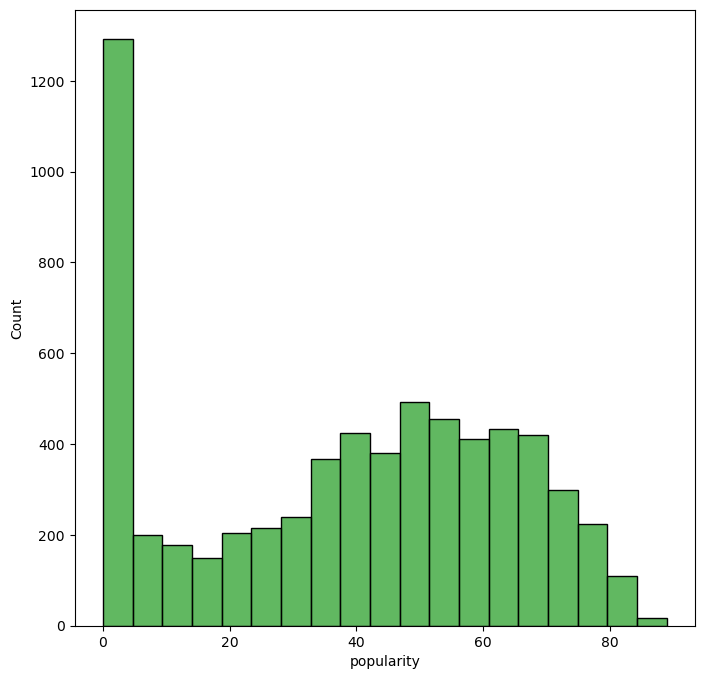

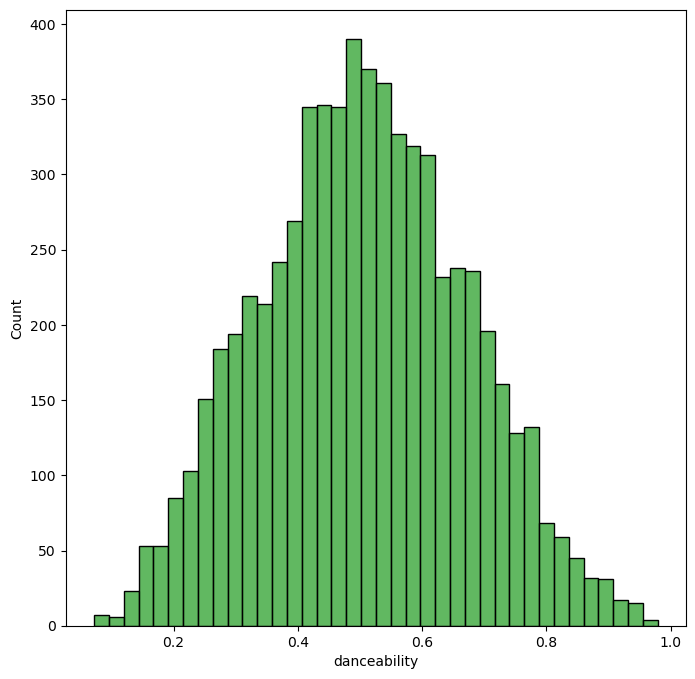

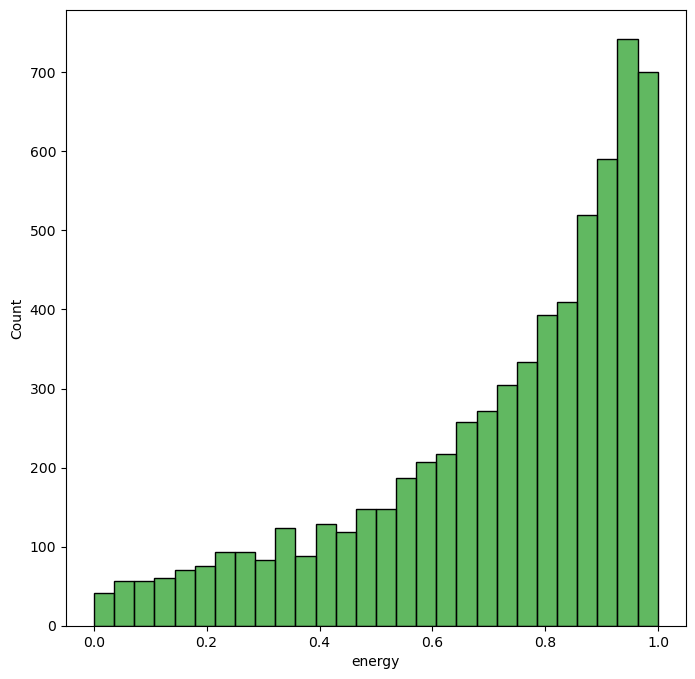

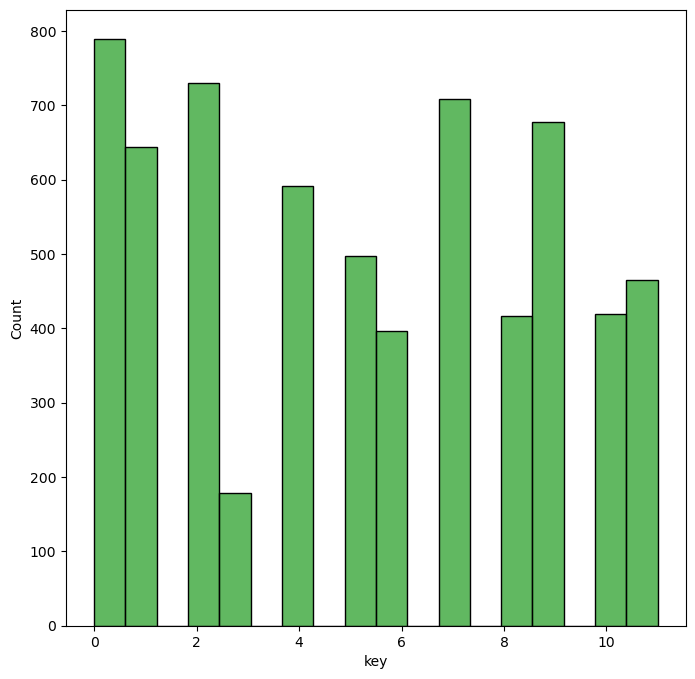

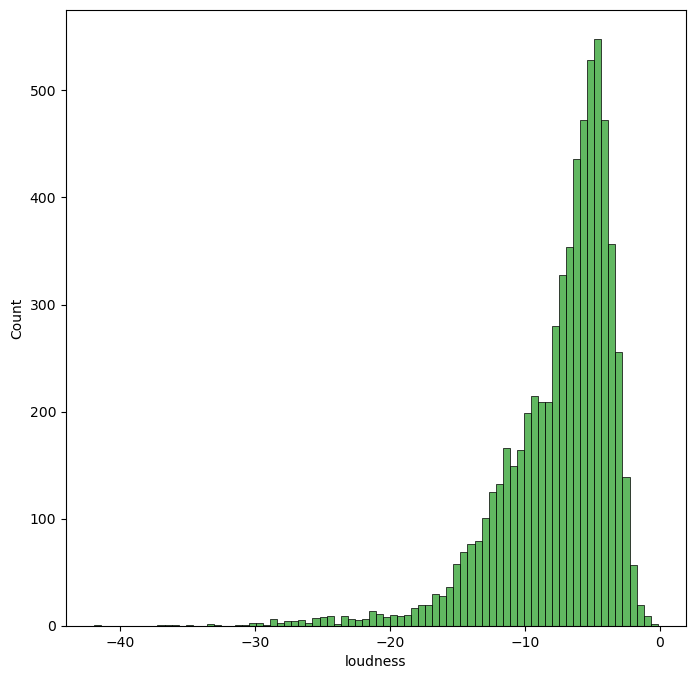

...

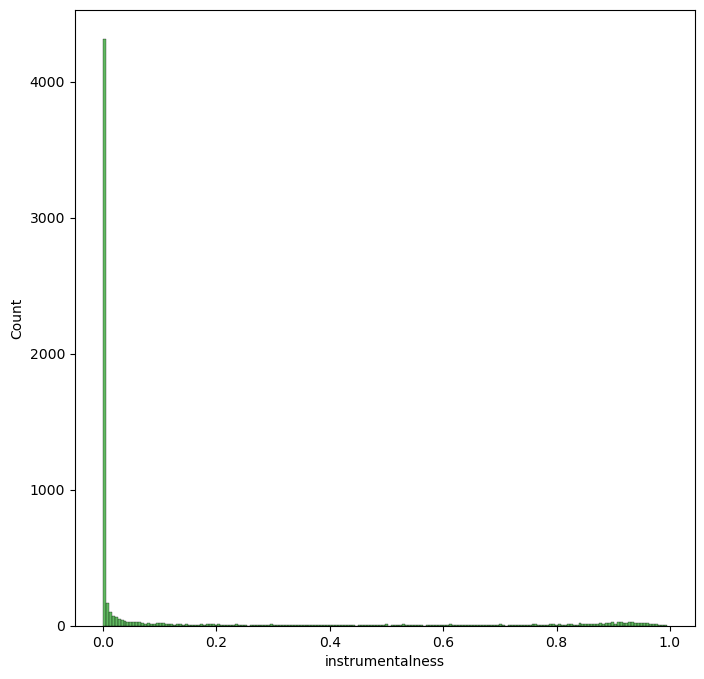

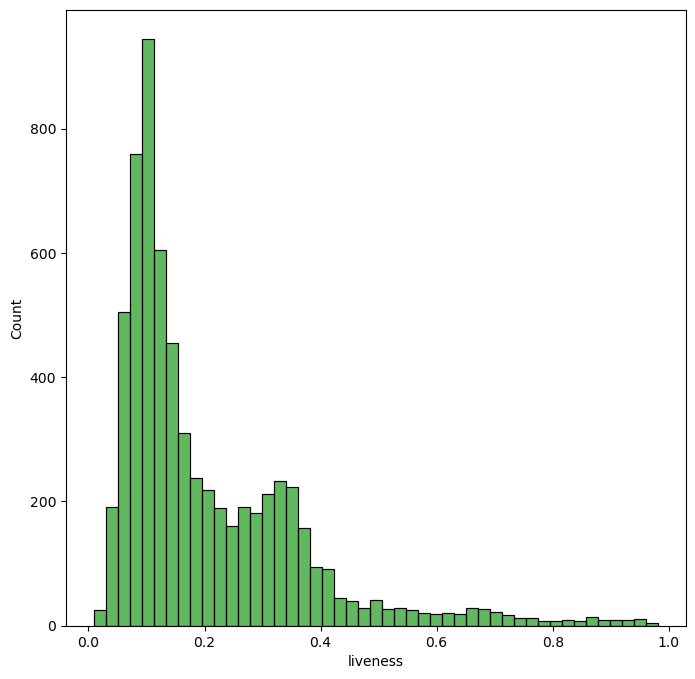

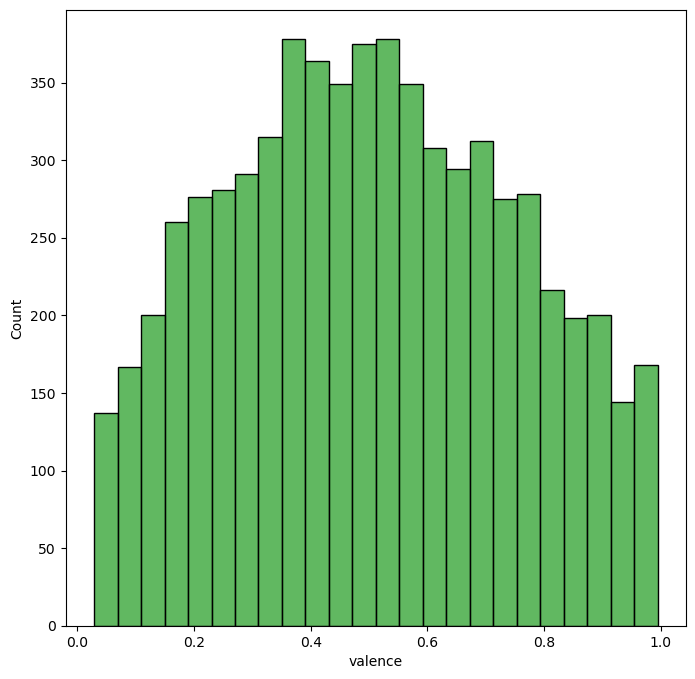

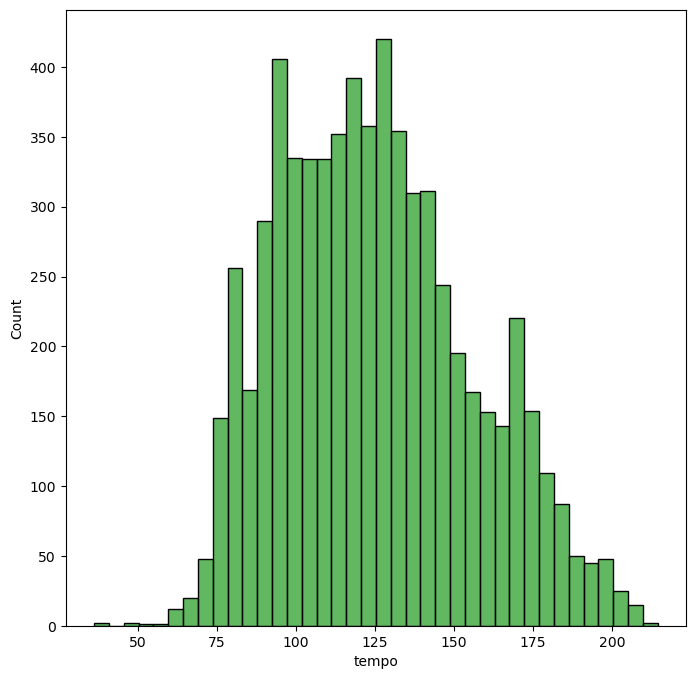

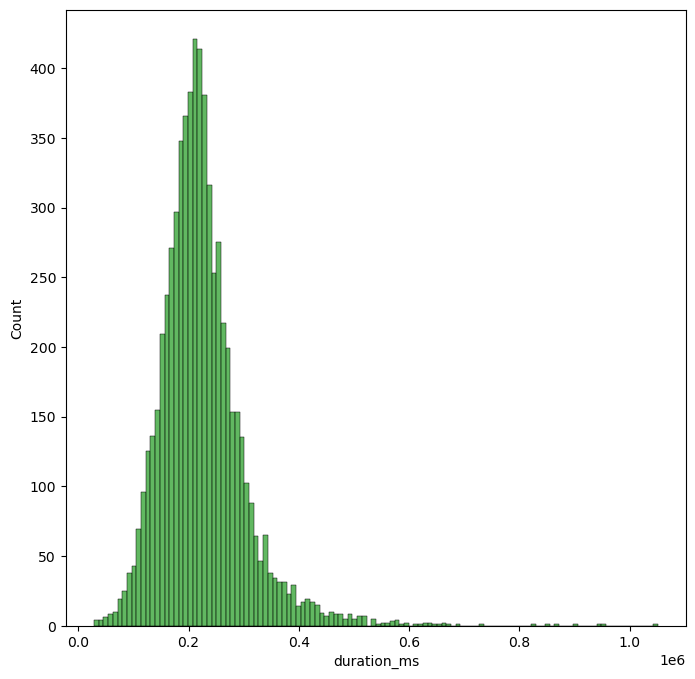

In [15]:
#Loopuing through dataframe to check distributions of numerical features
for col in num_features:
    fig, axes = plt.subplots(figsize = (8,8))
    sns.histplot(x=col, data = num_features, color="tab:green")

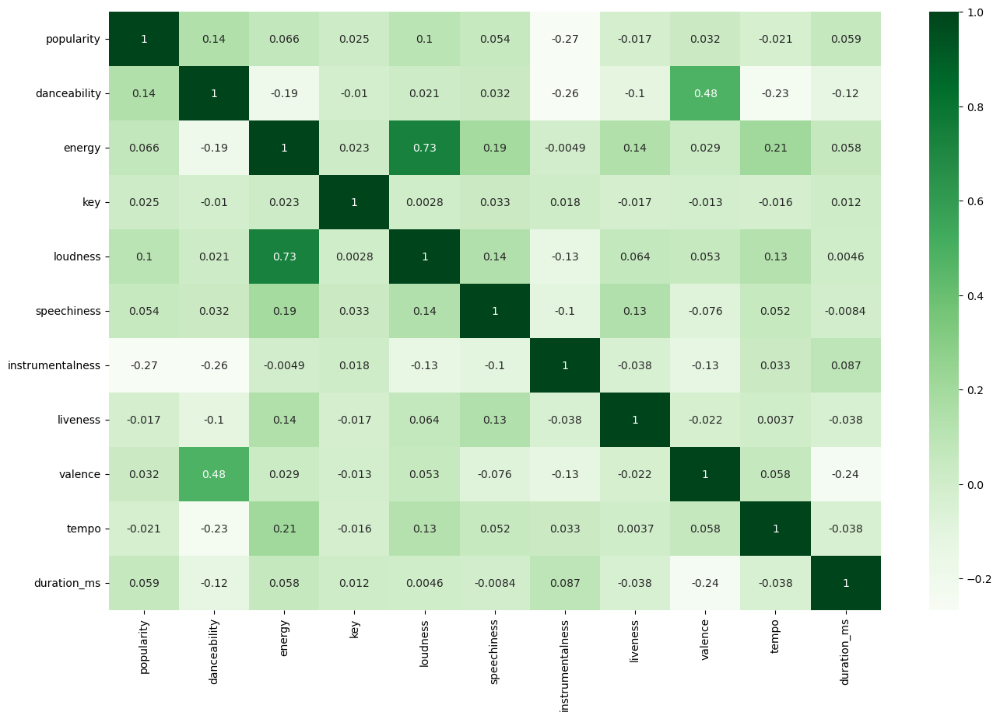

In [16]:
#Checking for correlations between features
fig, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(num_features.corr(), cmap ="Greens", annot=True);

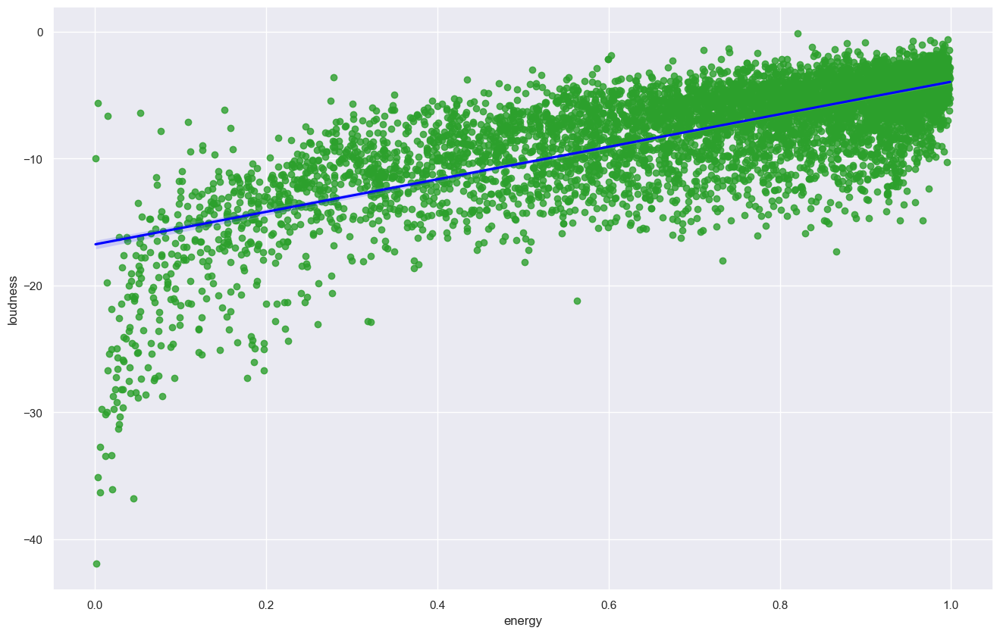

In [17]:
#Plotting relationship with most correlated features
sns.set_theme(color_codes=True)
plt.subplots(figsize=(16,10))
sns.regplot(x = 'energy', y = 'loudness', data=spot_df, scatter_kws={"color": "tab:green"}, line_kws={"color": "blue"});

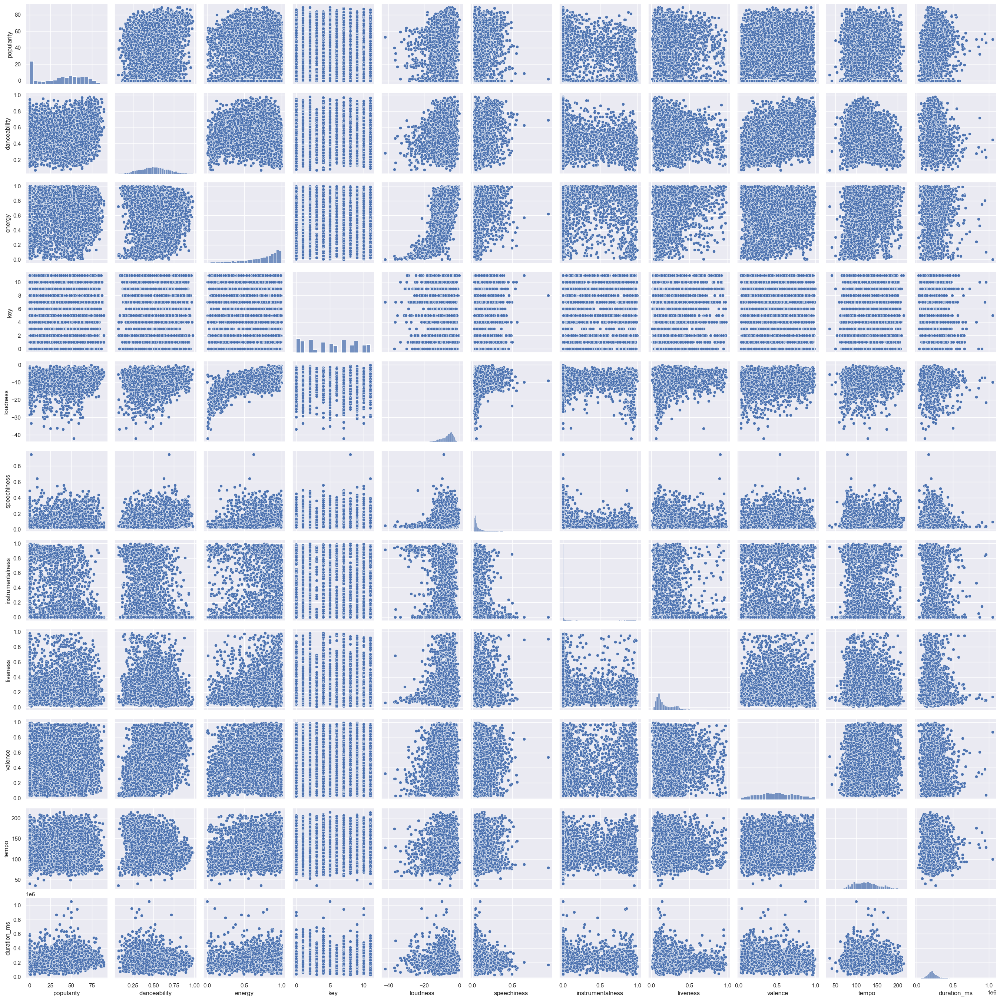

In [18]:
#Plotting relationships with features
sns.pairplot(num_features);

In [19]:
#Checking the means of top 50 songs and bottom 50 songs based on popularity
print("Top 50 Songs means\n --------------------------- \n" , num_features.sort_values(['popularity']).head(50).mean())
print("\n")
print("Bottom 50 songs means\n --------------------------- \n", num_features.sort_values(['popularity']).tail(50).mean())

Top 50 Songs means
 --------------------------- 
 popularity               0.000000
danceability             0.543240
energy                   0.793400
key                      3.980000
loudness                -5.560980
speechiness              0.078846
instrumentalness         0.047895
liveness                 0.205490
valence                  0.474420
tempo                  124.068260
duration_ms         223022.000000
dtype: float64


Bottom 50 songs means
 --------------------------- 
 popularity              84.400000
danceability             0.627200
energy                   0.675220
key                      5.520000
loudness                -6.315100
speechiness              0.093498
instrumentalness         0.026515
liveness                 0.165008
valence                  0.525280
tempo                  121.484640
duration_ms         235406.760000
dtype: float64


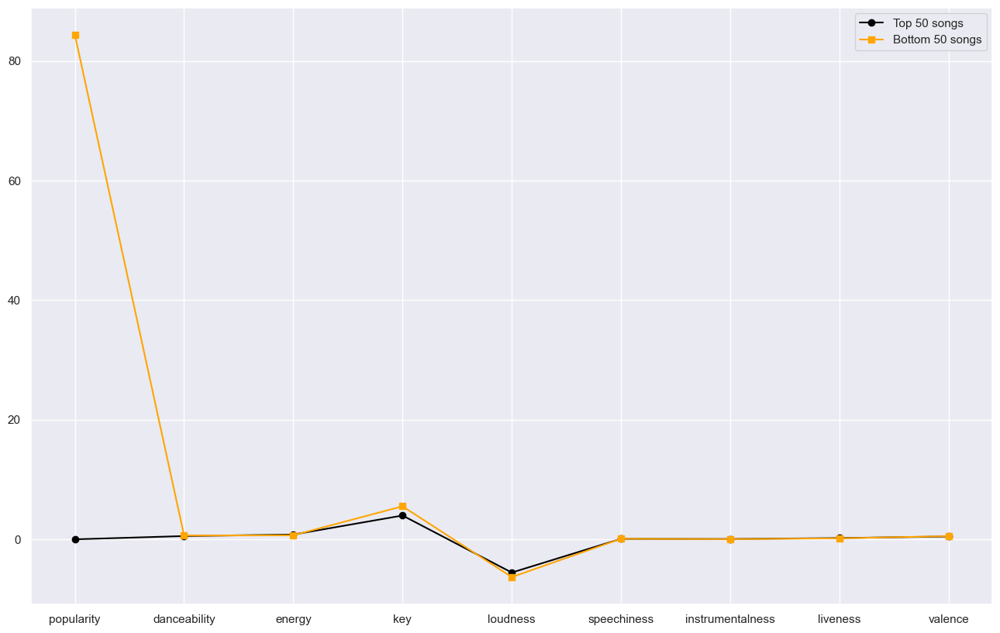

In [20]:
#Plotting the relationship of the means between the top and bottom 50 songs
top50 = num_features.sort_values(['popularity']).head(50).drop(['duration_ms', 'tempo'], axis=1).mean()
bot50 = num_features.sort_values(['popularity']).tail(50).drop(['duration_ms', 'tempo'], axis=1).mean()

fig, ax = plt.subplots(figsize = (16,10))
plt.plot(top50, color = 'black', marker = 'o')
plt.plot(bot50, color = "orange", marker = 's')
plt.legend(['Top 50 songs', 'Bottom 50 songs']);


In [21]:
#Making a copy of the original dataframe
rec_df = spot_df.copy()
rec_df.head()

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


In [22]:
# Creating df with just the audio features
rec_df_features = rec_df.select_dtypes(np.number)

In [23]:
#Checking the first 5 rows of the dataframe
rec_df_features.head()

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


# Modeling

In [24]:
# https://towardsdatascience.com/how-to-build-an-amazing-music-recommendation-system-4cce2719a572

def PCA_pipeline(scaler, df):
    
    """
    
    Function
    --------------------------------------
    This function converts a DataFrame to only include its numerical columns. It then scales the dataframe and uses PCA 
    to create a 2 dimensional array for plotting. The output is a DataFrame that includes the output values of the PCA 
    components along with the artist, title of the song and cluster in which it belongs to.
    
    
    """
    
    pca_pipeline = Pipeline([('scaler', scaler), ('PCA', PCA(n_components=2))])
    songs = df.select_dtypes(np.number) 
    song_embedding = pca_pipeline.fit_transform(songs)
    projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
    projection['artist'] = df['artist']
    projection['title'] = df['track_name']
    projection['cluster'] = df['cluster_label']
    return projection

In [25]:
def plot_clusters(projection, x, y):
    
    """
    
    Function
    --------------------------------------
    This function takes the data generated from the PCA_pipeline function and plots the information along with the songs
    for visual purposes
    
    """
    
    fig = px.scatter(projection, x= 'x', y= 'y', color='cluster', hover_data=['x', 'y', 'title'])
    fig.show()

In [26]:
def clustering_metrics(df_num, preds):
    
    """
    
    Function
    --------------------------------------
    This function uses the numerical columns of a DataFrame along with the predictions generated to measure the performance
    of unsupervised learning tasks.
    
    """
    
    print('Silhouette Score: ', silhouette_score(df_num, preds), '\n\n -------------------------- \n\n')
    print('Calinski Harabasz Score: ', calinski_harabasz_score(df_num, preds), 
          ' \n\n -------------------------- \n\n')
    
    print('Davies Bouldin Score: ', davies_bouldin_score(df_num, preds), '\n\n -------------------------- \n\n')

In [27]:
# https://stackoverflow.com/questions/44636370/scikit-learn-gridsearchcv-without-cross-validation-unsupervised-learning

def cv_silhouette_scorer(estimator, X):
    
    """
    
    Function
    --------------------------------------
    This function calculates the silhouette score of a clustering algorithm that could be inputted to a GridSearchCV for the
    "scoring" parameter.
    
    """
    
    estimator.fit(X)
    cluster_labels = estimator['model'].labels_
    num_labels = len(set(cluster_labels))
    num_samples = len(X.index)
    if num_labels == 1 or num_labels == num_samples:
        return -1
    else:
        return silhouette_score(X, cluster_labels)

#Stops Gridsearch from crossvalidating
cv = [(slice(None), slice(None))]

## Working with UMAP

In [28]:
#Creating a copy of the dataset for modifications
umap_play_df = rec_df_features.copy()
umap_play_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [29]:
#Instantiating UMAP
reducer = umap.UMAP()

In [30]:
#Instantiating scaler
ss = StandardScaler()

In [31]:
#Scaling data
umap_play_df_scaled = ss.fit_transform(umap_play_df)

In [32]:
#Transforming scaled data using UMAP
umap_play_df_embedded = reducer.fit_transform(umap_play_df_scaled)

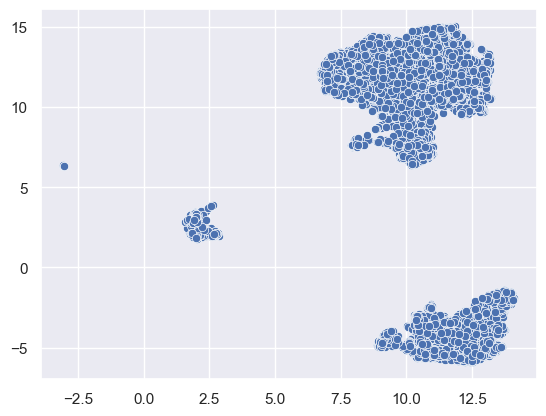

In [33]:
#Plotting output of UMAP
sns.scatterplot(x = umap_play_df_embedded[:, 0], y = umap_play_df_embedded[:, 1], data = umap_play_df_embedded);

In [34]:
#Checking to make sure the number of rows outputted match the data
np.count_nonzero(umap_play_df_embedded[:, 0])

6513

In [35]:
# Making function to see affects of umap on the data
def draw_umap(n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean', title=''):
    
    """
    Function
    --------------------------------------
    This function takes the output of UMAP and plots the output based on the number of components.
    
    """
    fit = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric
    )
    u = fit.fit_transform(umap_play_df_scaled);
    fig = plt.figure()
    if n_components == 1:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], range(len(u)))
    if n_components == 2:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], u[:,1])
    if n_components == 3:
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(u[:,0], u[:,1], u[:,2], s=100)
    plt.title(title, fontsize=18)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


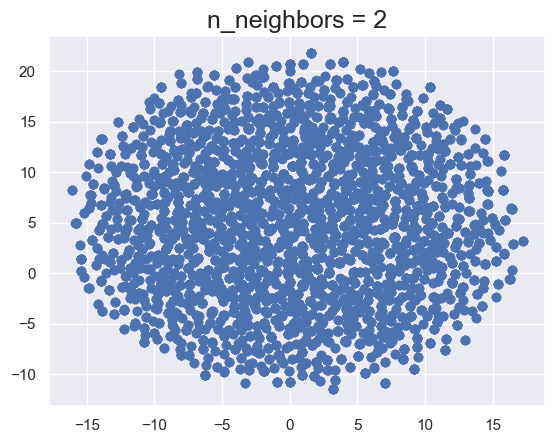

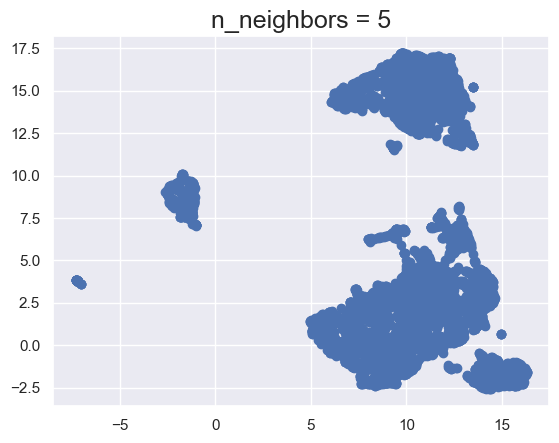

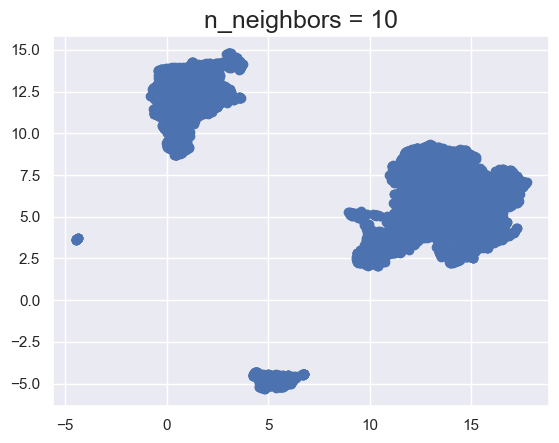

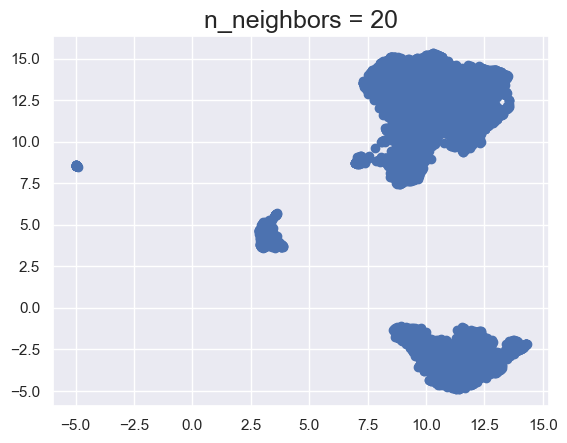

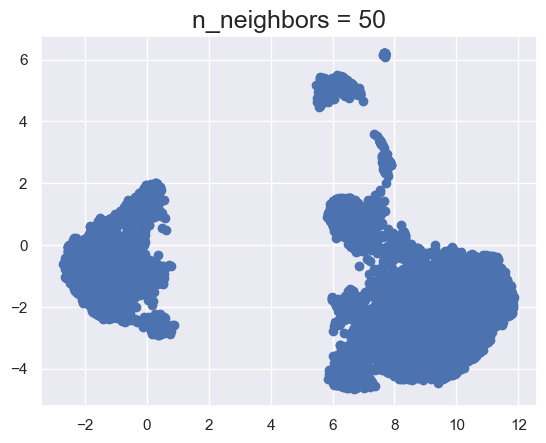

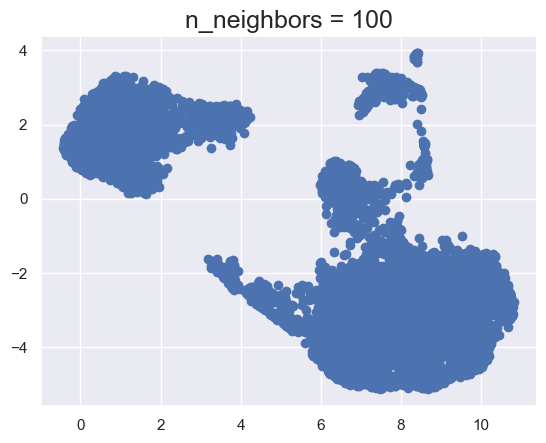

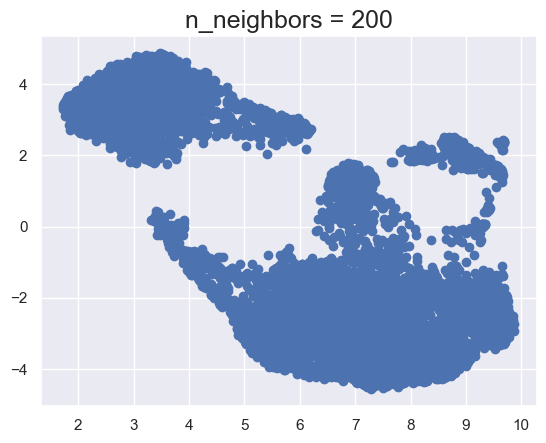

In [36]:
#Looping through n_neigbors parameter of UMAP
for n in (2, 5, 10, 20, 50, 100, 200):
    draw_umap(n_neighbors=n, title='n_neighbors = {}'.format(n), n_components=2)

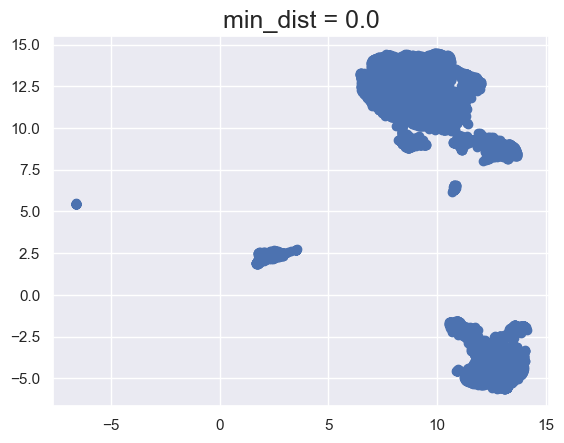

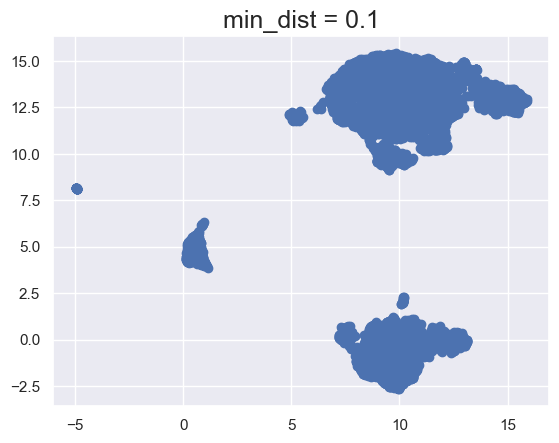

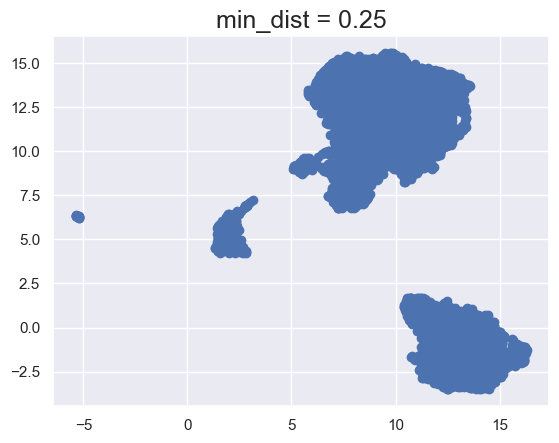

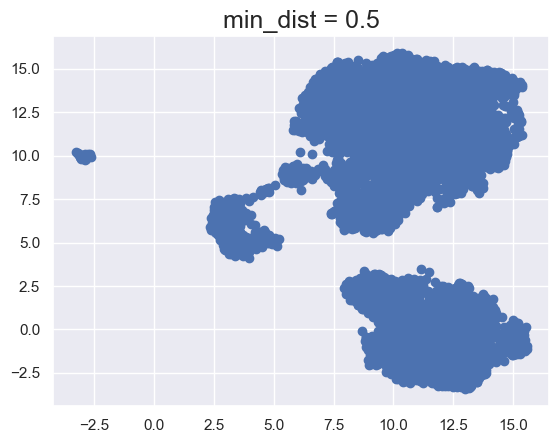

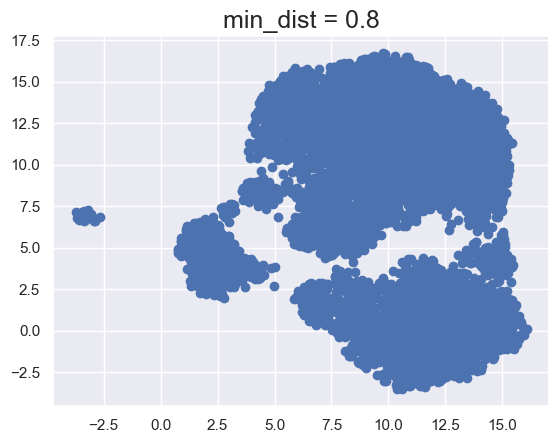

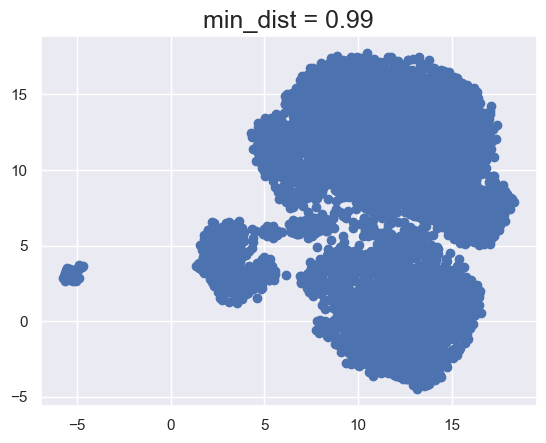

In [37]:
#Looping through min_dist parameter of UMAP
for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
    draw_umap(min_dist=d, title='min_dist = {}'.format(d), n_components=2)

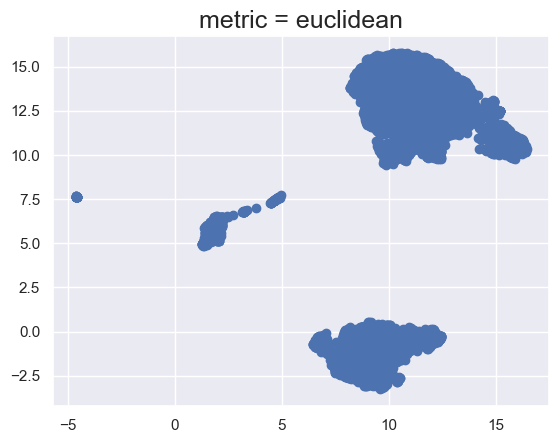

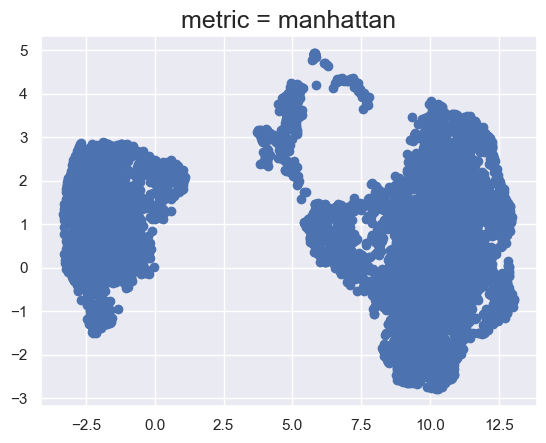

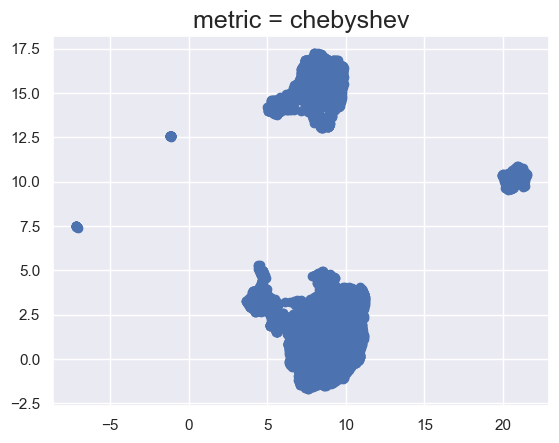

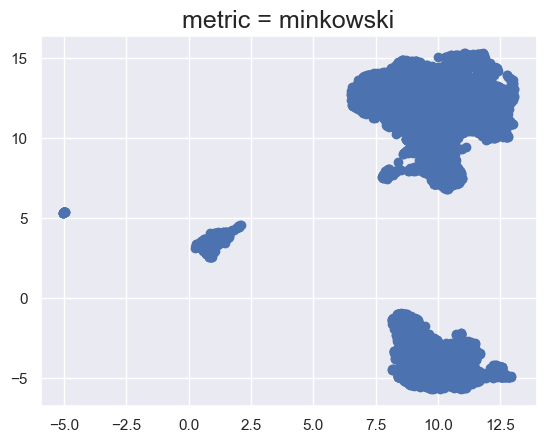

In [38]:
#Looping through metric parameter of UMAP
for m in ("euclidean", "manhattan", "chebyshev", "minkowski"):
    draw_umap(n_components=2, metric=m, title='metric = {}'.format(m))
    

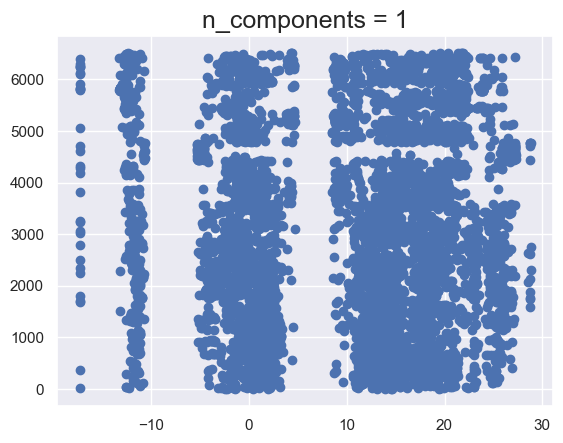

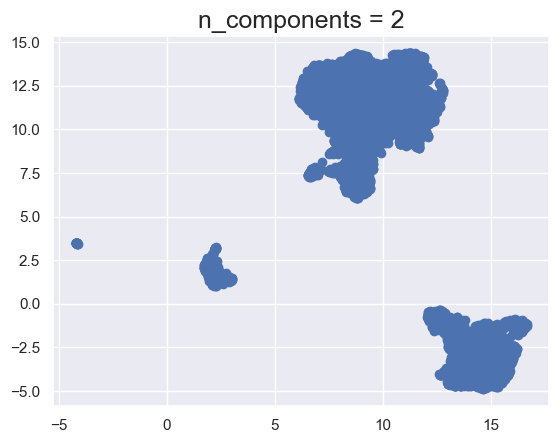

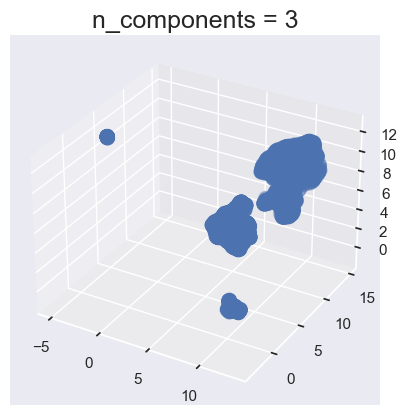

In [39]:
#Looping through n_components parameter of UMAP
for n in (1, 2, 3):
    draw_umap(n_components=n, title='n_components = {}'.format(n))

## <u>KMeans<u/>

### Baseline KMeans with no dimensionality reduction

In [40]:
#Setting up pipeline to scale data and perform kmeans on the data
kmeans_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('kmeans', KMeans())])

In [41]:
#Creating a copy DataFrame for modeling
kmeans_base_song_df = rec_df.select_dtypes(np.number)
kmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [42]:
#Predicting clusters based on the DataFrame
song_base_labels = kmeans_base_cluster_pipeline.fit_predict(kmeans_base_song_df)

In [43]:
#Adding cluster outputs, artist and track names to the DataFrame
kmeans_base_song_df['cluster_label'] = song_base_labels
kmeans_base_song_df['artist'] = rec_df['artist']
kmeans_base_song_df['track_name'] = rec_df['track_name']

In [44]:
#Checking columns
kmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,5,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [45]:
#Checking unsupervised learning metrics
clustering_metrics(kmeans_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), song_base_labels)

Silhouette Score:  -0.0852946604964592 

 -------------------------- 


Calinski Harabasz Score:  553.5956686186441  

 -------------------------- 


Davies Bouldin Score:  37.68727787496544 

 -------------------------- 




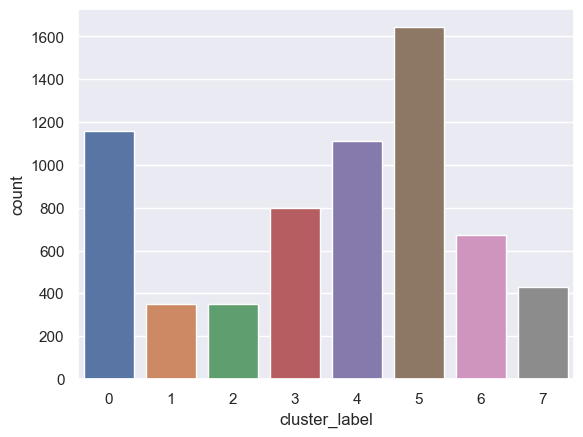

In [46]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=kmeans_base_song_df, x = 'cluster_label');

In [47]:
#Checking how many songs are assigned to each cluster
kmeans_base_song_df['cluster_label'].value_counts()

5    1644
0    1156
4    1113
3     800
6     671
7     429
2     352
1     348
Name: cluster_label, dtype: int64

In [48]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_base = PCA_pipeline(StandardScaler(), kmeans_base_song_df)

In [49]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_base, 'x', 'y')

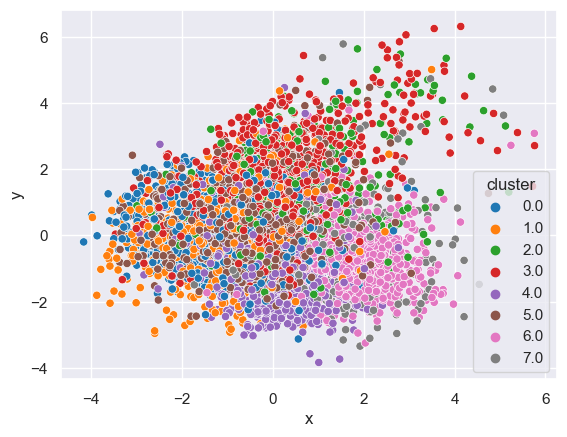

In [50]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline KMeans with UMAP

In [51]:
#Setting up pipeline to scale data, do dimensionality reduction using UMAP and perform kmeans on the data
kmeans_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                            ('umap', umap.UMAP()),
                                            ('kmeans', KMeans())])

In [52]:
#Creating a copy DataFrame for modeling
kmeans_song_df = rec_df.select_dtypes(np.number)
kmeans_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [53]:
#Predicting clusters based on the DataFrame
song_cluster_labels = kmeans_cluster_pipeline.fit_predict(kmeans_song_df)

In [54]:
#Adding cluster to the DataFrame
kmeans_song_df['cluster_label'] = song_cluster_labels

In [55]:
#Checking columns
kmeans_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [56]:
#Checking unsupervised learning metrics
clustering_metrics(kmeans_song_df.drop('cluster_label', axis=1), song_cluster_labels)

Silhouette Score:  -0.13742202698330738 

 -------------------------- 


Calinski Harabasz Score:  62.15880190035249  

 -------------------------- 


Davies Bouldin Score:  35.83011923810589 

 -------------------------- 




In [57]:
#Going into pipeline to get values of UMAP for visualization
kmeans_umap_db = kmeans_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [58]:
#Inputting UMAP output into a DataFrame 
kmeans_umap_df = pd.DataFrame(kmeans_umap_db, columns=['umap_1', 'umap_2'])

In [59]:
#Inputting clusters they were assigned to
kmeans_umap_df['cluster'] = kmeans_song_df['cluster_label']

In [60]:
#Checking columns
kmeans_umap_df

,umap_1,umap_2,cluster
0,12.029869,12.398316,6.0
1,12.040604,12.379055,4.0
2,12.043348,12.431768,0.0
3,12.026351,12.392467,1.0
4,12.040092,12.370185,0.0
...,...,...,...
6508,12.029737,12.386863,3.0
6509,12.025996,12.422077,0.0
6510,12.056089,12.392553,1.0
6511,12.046970,12.406248,0.0


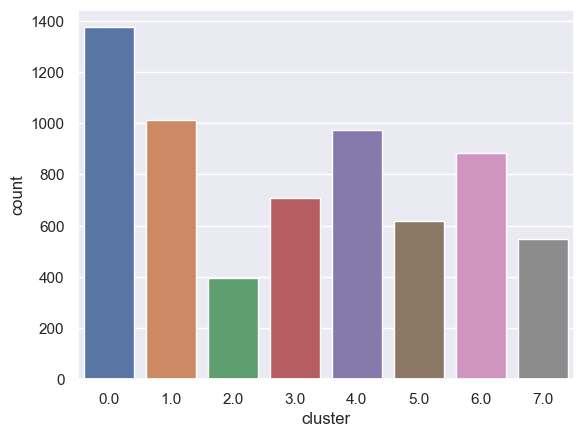

In [61]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=kmeans_umap_df, x = 'cluster');

In [62]:
#Checking how many songs are assigned to each cluster
kmeans_umap_df['cluster'].value_counts()

0.0    1375
1.0    1011
4.0     973
6.0     882
3.0     709
5.0     620
7.0     548
2.0     394
Name: cluster, dtype: int64

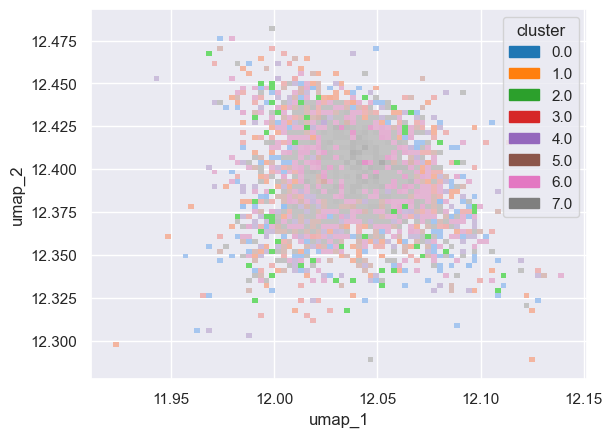

In [63]:
#Visualizing clusters using seaborn's histplot
sns.histplot(x = 'umap_1', y = 'umap_2', data = kmeans_umap_df, hue = 'cluster', palette = 'tab10');

In [64]:
#Visualizing clusters using plotly's scatterplot
px.scatter(kmeans_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Baseline KMeans with PCA

In [65]:
#Creating a copy DataFrame for modeling
pca_kmeans_df = rec_df.copy()

In [66]:
#Checking columns
pca_kmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [67]:
#Setting up pipeline to scale data, do dimensionality reduction using PCA and perform kmeans on the data
kmeans_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('kmeans', KMeans())])

In [68]:
#Generating predictions on the dataset
pca_kmeans_preds = kmeans_pca_cluster_pipeline.fit_predict(pca_kmeans_df.select_dtypes(np.number))

In [69]:
#Checking output of predictions
pca_kmeans_preds

array([5, 1, 7, ..., 7, 0, 2])

In [70]:
#Checking values of components in PCA
kmeans_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [71]:
#Checking the variance of each component
kmeans_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [72]:
#Inputting predictions into the dataframe
pca_kmeans_df['cluster_label'] = pca_kmeans_preds

In [73]:
#Checking dataframe after clustering
pca_kmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,5
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,7
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,7
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [74]:
# Using PCA to turn information into 2 dimensions for visualization purposes
projection_kmeans = PCA_pipeline(StandardScaler(), pca_kmeans_df)

In [75]:
#Checking outcome
projection_kmeans

,x,y,artist,title,cluster
0,-0.226322,-0.899424,Bon Jovi,Livin' On A Prayer,5.0
1,2.513850,0.333552,Bon Jovi,Wanted Dead Or Alive,1.0
2,-0.862724,0.589886,Queen,We Are The Champions - Remastered 2011,7.0
3,-1.661620,-0.281656,Queen,We Will Rock You - Remastered 2011,5.0
4,-0.792500,-1.557921,Bon Jovi,You Give Love A Bad Name,7.0
...,...,...,...,...,...
6508,-0.193324,-1.293724,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,-2.330935,-0.302685,N.W.A.,Gangsta Gangsta,0.0
6510,-1.264298,-2.511078,Various Artists,Rollin' With My Homies,5.0
6511,0.329508,-2.133330,Nas,N.Y. State of Mind,7.0


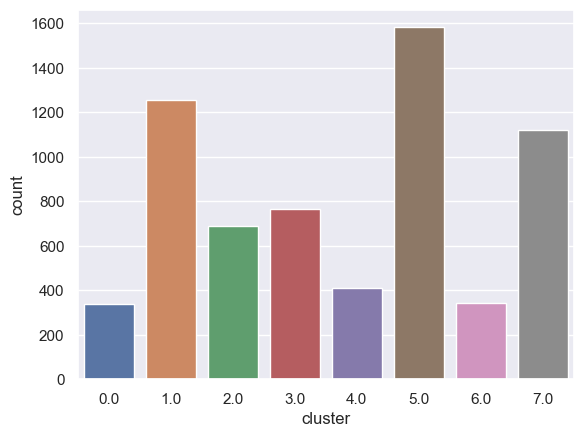

In [76]:
#Visualizing how many values are in each cluster
sns.countplot(data=projection_kmeans, x = 'cluster');

In [77]:
#Checking how many values are in each cluster
projection_kmeans['cluster'].value_counts()

5.0    1583
1.0    1257
7.0    1120
3.0     767
2.0     691
4.0     412
6.0     344
0.0     338
Name: cluster, dtype: int64

In [78]:
#Visualizing each datapoint using scatterplot using plotly
plot_clusters(projection_kmeans, 'x', 'y')

In [79]:
#Checking metrics to see how well each cluster was made
clustering_metrics(pca_kmeans_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_kmeans_preds)

Silhouette Score:  -0.12181225049738809 

 -------------------------- 


Calinski Harabasz Score:  44.13347178136935  

 -------------------------- 


Davies Bouldin Score:  207.62082402076706 

 -------------------------- 




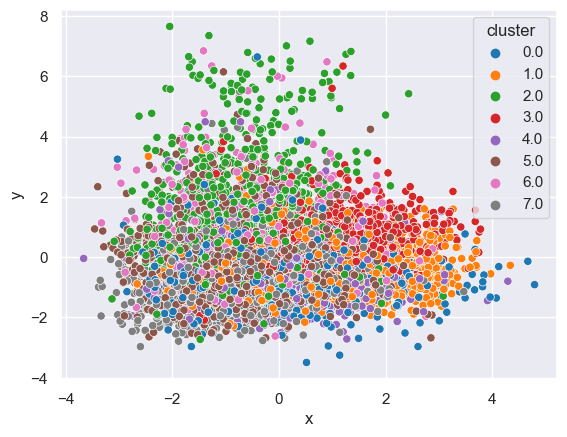

In [80]:
#Visualizing each datapoint using scatterplot using seaborn
sns.scatterplot(data = projection_kmeans, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch KMeans with UMAP

In [81]:
#Creating a copy DataFrame for modeling
gs_kmeans_umap_df = rec_df.copy().select_dtypes(np.number) 

In [82]:
#Checking copied df
gs_kmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [83]:
#Setting up pipeline to scale data, do dimensionality reduction using UMAP and perform kmeans on the data
kmeans_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', KMeans())])


In [84]:
#Setting up grid parameters to create models with a combination of each of the parameters
kmeans_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__n_init':[10, 50, 100],
                        }


In [85]:
#Setting up gridseach with pipeline, parameters, a silhoutte scorer function and a function that stops cv
kmeans_gs_umap = GridSearchCV(estimator=kmeans_pipe_gs_umap, 
                              param_grid = kmeans_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [86]:
#Initating model
kmeans_gs_umap.fit(gs_kmeans_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()), ('model', KMeans())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__n_init': [10, 50, 100],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [87]:
#Checking the best parameters for the model
kmeans_gs_umap.best_params_

{'model__n_clusters': 7,
 'model__n_init': 10,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [88]:
#Checking the best score given for the model
kmeans_gs_umap.best_score_

-0.04368463139780689

In [89]:
# Checking that the custom scorer was successful
kmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [90]:
#Creating a variable for the predictions
preds_kmeans_umap = kmeans_gs_umap.predict(gs_kmeans_umap_df)

In [91]:
#Checking the predictions
preds_kmeans_umap

array([1, 5, 6, ..., 6, 4, 1])

In [92]:
#Adding the predictions to the dataframe
gs_kmeans_umap_df['cluster'] = preds_kmeans_umap

In [93]:
#Checking the output
gs_kmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,5
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,6
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,3
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,6
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,4


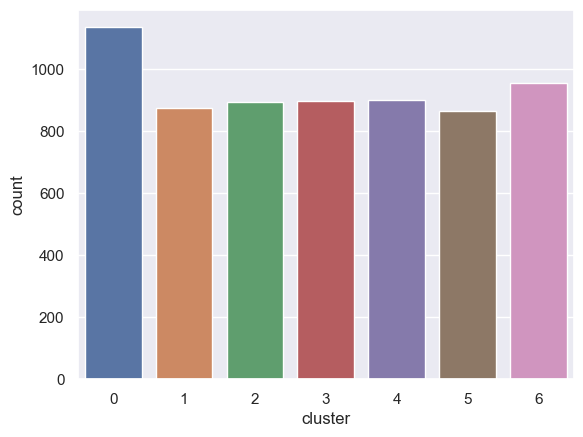

In [94]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=gs_kmeans_umap_df, x = 'cluster');

In [95]:
#Checking how many songs are assigned to each cluster
gs_kmeans_umap_df['cluster'].value_counts()

0    1134
6     954
4     900
3     895
2     892
1     873
5     865
Name: cluster, dtype: int64

In [96]:
#Using umap step to provide 2 dimensional data for visualization
kmeans_gs_umap_db = kmeans_gs_umap.best_estimator_.named_steps['umap'].transform(gs_kmeans_umap_df.drop('cluster', axis=1))

In [97]:
#Creating a dataframe for the data
kmeans_gs_umap_df = pd.DataFrame(kmeans_gs_umap_db, columns=['umap_1', 'umap_2'])

In [98]:
#Checking to see if there are any missing values
kmeans_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [99]:
#Adding cluster information to umap dataframe
kmeans_gs_umap_df['cluster'] = gs_kmeans_umap_df['cluster']

In [100]:
kmeans_gs_umap_df

,umap_1,umap_2,cluster
0,-4.332379,-7.943819,1.0
1,-4.405775,-7.836816,5.0
2,-4.355100,-7.867772,6.0
3,-4.304548,-7.898817,4.0
4,-4.416769,-7.823326,5.0
...,...,...,...
6508,-4.357242,-7.852406,2.0
6509,-4.544444,-7.913064,6.0
6510,-4.429865,-7.877372,3.0
6511,-4.294349,-8.027165,6.0


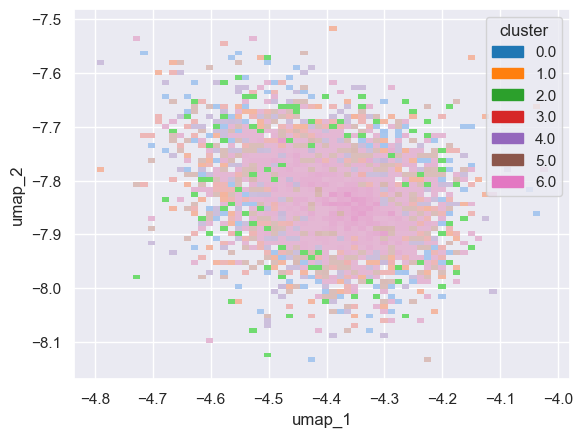

In [101]:
#Plotting umap data using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = kmeans_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [102]:
#plotting umap data using plotly
px.scatter(kmeans_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch KMeans with PCA

In [103]:
#Creating a copy DataFrame for modeling
gs_kmeans_pca_df = rec_df.copy().select_dtypes(np.number)

In [104]:
#Checking copied df
gs_kmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [105]:
#Setting up pipeline to scale data, do dimensionality reduction using PCA and perform kmeans on the data
kmeans_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', KMeans())])

In [106]:
#Setting up grid parameters to create models with a combination of each of the parameters
kmeans_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__n_init':[10, 50, 100]
                  }


In [107]:
#Setting up gridseach with pipeline, parameters, a silhoutte scorer function and a function that stops cv
kmeans_gs_pca = GridSearchCV(estimator=kmeans_pipe_gs_pca,
                             param_grid = kmeans_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [108]:
#Initating model
kmeans_gs_pca.fit(gs_kmeans_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()), ('model', KMeans())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__n_init': [10, 50, 100],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [109]:
#Creating a variable for the predictions
preds = kmeans_gs_pca.predict(gs_kmeans_pca_df)

In [110]:
#Adding the predictions to the dataframe
gs_kmeans_pca_df['cluster'] = preds

In [111]:
#Checking the output
gs_kmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,5
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,6


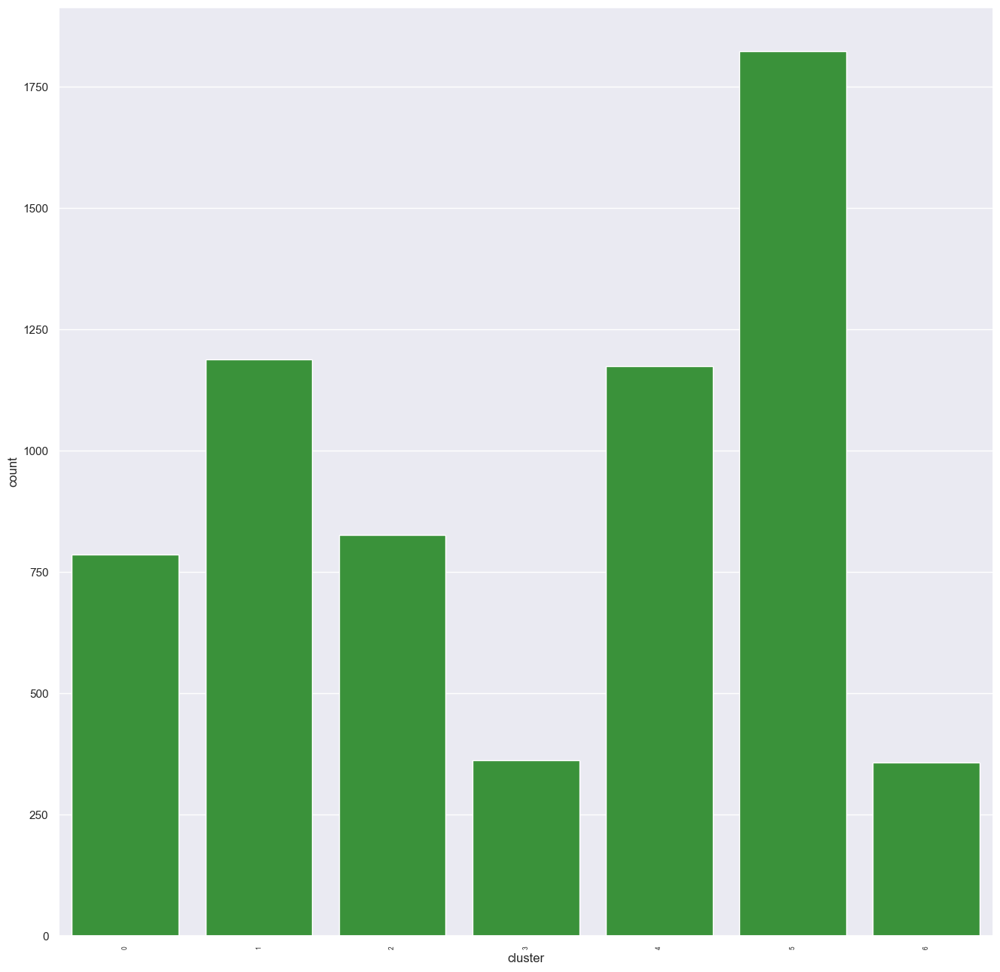

In [112]:
#Visualizing counts of songs assigned to each cluster
plt.subplots(figsize = (16, 16))
plt.xticks(rotation=90)
plt.tick_params(axis= 'x', labelsize=6)
sns.countplot(data=gs_kmeans_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [113]:
#Checking unsupervised learning metrics
clustering_metrics(gs_kmeans_pca_df, preds)

Silhouette Score:  -0.09634801401694403 

 -------------------------- 


Calinski Harabasz Score:  30.546560479176396  

 -------------------------- 


Davies Bouldin Score:  104.47168394184335 

 -------------------------- 




In [114]:
#Checking the best parameters for the model
kmeans_gs_pca.best_params_

{'model__n_clusters': 7, 'model__n_init': 50, 'pca__n_components': 9}

In [115]:
#Checking the best score given for the model
kmeans_gs_pca.best_score_

-0.09480584756678853

In [116]:
# Checking that the custom scorer was successful
kmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [117]:
# Using PCA to turn information into 2 dimensions for visualization purposes
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
songs = gs_kmeans_pca_df 
song_embedding = pca_pipeline.fit_transform(songs)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['artist'] = rec_df['artist']
projection['title'] = rec_df['track_name']
projection['cluster'] = gs_kmeans_pca_df['cluster']

In [118]:
#Checking output
projection

,x,y,artist,title,cluster
0,-1.336272,-0.251415,Bon Jovi,Livin' On A Prayer,5.0
1,-0.500811,2.132734,Bon Jovi,Wanted Dead Or Alive,4.0
2,1.623185,0.390994,Queen,We Are The Champions - Remastered 2011,1.0
3,-0.704644,-2.104757,Queen,We Will Rock You - Remastered 2011,5.0
4,-0.325748,0.164525,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-1.802270,-1.586774,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,0.0
6509,-0.483561,-2.627462,N.W.A.,Gangsta Gangsta,6.0
6510,-1.125340,-0.854182,Various Artists,Rollin' With My Homies,5.0
6511,-2.609816,-1.190376,Nas,N.Y. State of Mind,1.0


In [119]:
#Visualizing each datapoint using scatterplot using plotly
plot_clusters(projection, 'x', 'y')

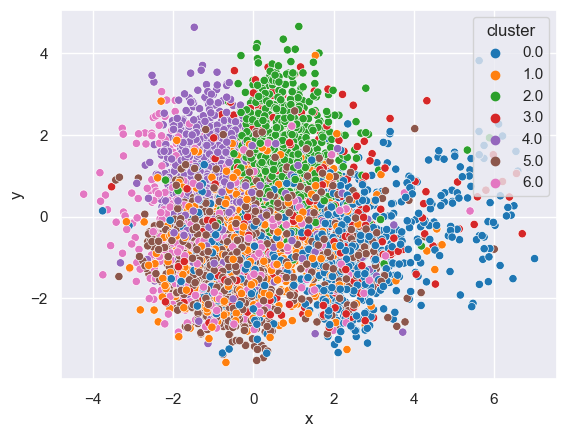

In [120]:
#Visualizing each datapoint using scatterplot using seaborn
sns.scatterplot(data = projection, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>Agglomerative Clustering<u/>

### Baseline Aggolmerative Clustering with no dimensionality reduction

In [121]:
#Setting up baseline pipeline with a scaler and agglomerative clustering
ac_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                             ('model', AgglomerativeClustering())])

In [122]:
#Creating a copy of a dataframe for modeling
ac_base_song_df = rec_df.select_dtypes(np.number)
ac_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [123]:
#Fitting and predicting clusters
ac_song_base_labels = ac_base_cluster_pipeline.fit_predict(ac_base_song_df)

In [124]:
#Adding predictions and song information to the dataframe
ac_base_song_df['cluster_label'] = ac_song_base_labels
ac_base_song_df['artist'] = rec_df['artist']
ac_base_song_df['track_name'] = rec_df['track_name']

In [125]:
#Checking output
ac_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [126]:
#Checking unsupervised learning metrics
clustering_metrics(ac_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), ac_song_base_labels)

Silhouette Score:  0.08927301182941944 

 -------------------------- 


Calinski Harabasz Score:  100.20587600284416  

 -------------------------- 


Davies Bouldin Score:  5.818777208759369 

 -------------------------- 




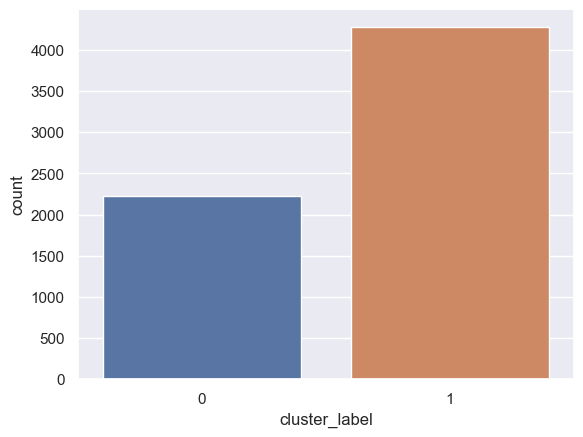

In [127]:
#VFisualizing counts of songs per clusters using seaborn
sns.countplot(data=ac_base_song_df, x = 'cluster_label');

In [128]:
#Checking counts of songs in each cluster
ac_base_song_df['cluster_label'].value_counts()

1    4282
0    2231
Name: cluster_label, dtype: int64

In [129]:
#Creating dataframe for visualization
projection_ac_base = PCA_pipeline(StandardScaler(), ac_base_song_df)

In [130]:
#Visualizing data using plotly
plot_clusters(projection_ac_base, 'x', 'y')

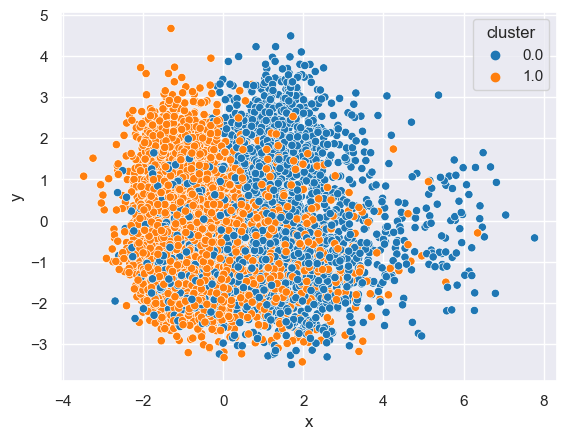

In [131]:
#Visualizing data using seaborn
sns.scatterplot(data = projection_ac_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline Aggolmerative Clustering with UMAP

In [132]:
#Setting up baseline pipeline with a scaler, umap for dimensionality reduction, and aggolerative clustering
ac_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', AgglomerativeClustering())])

In [133]:
#Creating a copy of the dataframe for modeling
ac_umap_song_df = rec_df.select_dtypes(np.number)
ac_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [134]:
#Fitting and predicting clusters using information in pipeline
ac_umap_song_cluster_labels = ac_cluster_pipeline.fit_predict(ac_umap_song_df)

In [135]:
#Adding predictions to the dataframe
ac_umap_song_df['cluster_label'] = ac_umap_song_cluster_labels

In [136]:
#Checking output
ac_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [137]:
#Checking unsupervised learning metrics
clustering_metrics(ac_umap_song_df.drop('cluster_label', axis=1), ac_umap_song_cluster_labels)

Silhouette Score:  -0.0010685116153567838 

 -------------------------- 


Calinski Harabasz Score:  9.464465763381186  

 -------------------------- 


Davies Bouldin Score:  17.601817018230815 

 -------------------------- 




In [138]:
#Using umap step in pipeline to get 2 dimensional data from dataframe for visualization
ac_umap_db = ac_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [139]:
#Creating a dataframe with umap outputs
ac_umap_df = pd.DataFrame(ac_umap_db, columns=['umap_1', 'umap_2'])

In [140]:
#Attaching predictions to umap dataframe
ac_umap_df['cluster'] = ac_umap_song_df['cluster_label']

In [141]:
#Checking output
ac_umap_df

,umap_1,umap_2,cluster
0,13.625190,10.786071,1.0
1,13.661201,10.808491,1.0
2,13.639915,10.786655,0.0
3,13.665559,10.772589,1.0
4,13.669582,10.837161,0.0
...,...,...,...
6508,13.638382,10.812784,1.0
6509,13.659595,10.800058,0.0
6510,13.640744,10.797333,1.0
6511,13.656940,10.824318,0.0


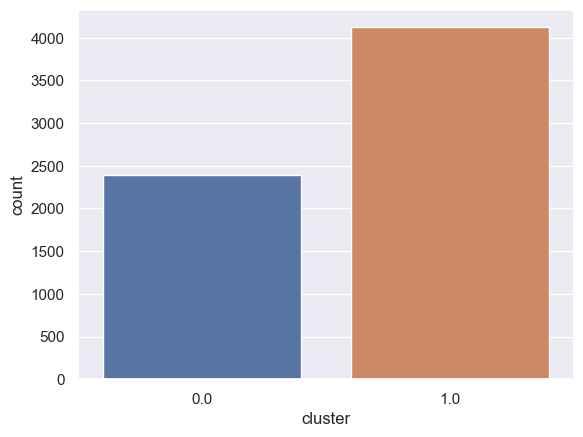

In [142]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=ac_umap_df, x = 'cluster');

In [143]:
#Checking counts of songs per song
ac_umap_df['cluster'].value_counts()

1.0    4122
0.0    2390
Name: cluster, dtype: int64

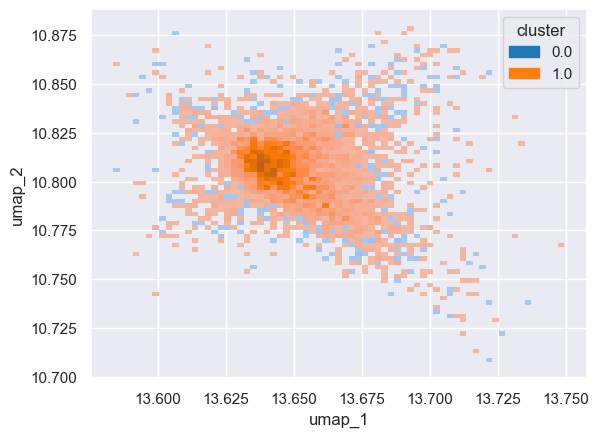

In [144]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = ac_umap_df, hue = 'cluster', palette = 'tab10');

In [145]:
#Visualizing clusters using plotly
px.scatter(ac_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

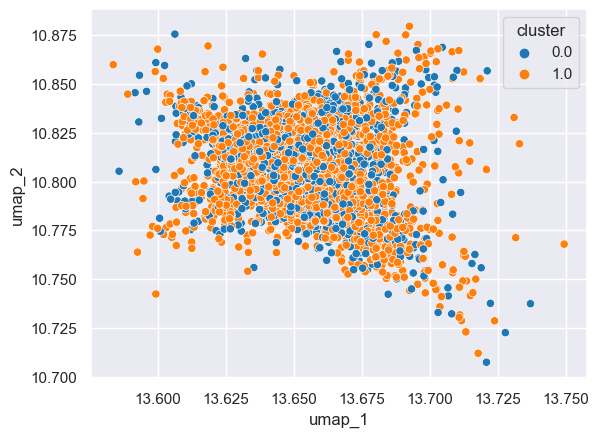

In [146]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = ac_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline Aggolmerative Clustering with PCA

In [147]:
#Creating a copy of the dataframe for modeling
pca_ac_df = rec_df.copy()

In [148]:
#Checking output
pca_ac_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [149]:
#Setting up baseline cluster pipeline with a scaler, pca for dimensionality reduction and agglomerative clustering
ac_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', AgglomerativeClustering())])

In [150]:
#Fitting and predicting clusters using the information in the pipeline
pca_ac_preds = ac_pca_cluster_pipeline.fit_predict(pca_ac_df.select_dtypes(np.number))

In [151]:
#Checking output
pca_ac_preds

array([1, 1, 1, ..., 1, 1, 0], dtype=int64)

In [152]:
#Checking pca components
ac_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [153]:
#Checking the amount of variance explained
ac_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [154]:
#Adding predictions to the dataframe
pca_ac_df['cluster_label'] = pca_ac_preds

In [155]:
#Checking output
pca_ac_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [156]:
#Creating dataframe for visualization by using pca
projection_ac_pca = PCA_pipeline(StandardScaler(), pca_ac_df)

In [157]:
#Checking output
projection_ac_pca

,x,y,artist,title,cluster
0,-0.937732,-0.437556,Bon Jovi,Livin' On A Prayer,1.0
1,-1.194289,1.960929,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.297669,0.607742,Queen,We Are The Champions - Remastered 2011,1.0
3,0.313385,-1.777719,Queen,We Will Rock You - Remastered 2011,1.0
4,-1.316342,-0.546431,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-1.015401,-2.050917,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,0.0
6509,1.691943,-2.278788,N.W.A.,Gangsta Gangsta,1.0
6510,-1.680559,-1.948409,Various Artists,Rollin' With My Homies,0.0
6511,-1.784736,-2.128663,Nas,N.Y. State of Mind,1.0


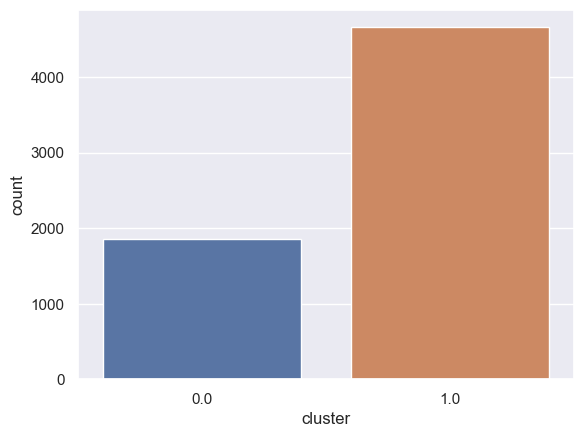

In [158]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=projection_ac_pca, x = 'cluster');

In [159]:
#Checking counts of songs per cluster
projection_ac_pca['cluster'].value_counts()

1.0    4659
0.0    1853
Name: cluster, dtype: int64

In [160]:
#VCisualizing clusters using plotly
plot_clusters(projection_ac_pca, 'x', 'y')

In [161]:
#Checking unsupervised learning metrics
clustering_metrics(pca_ac_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_ac_preds)

Silhouette Score:  0.016676632621063118 

 -------------------------- 


Calinski Harabasz Score:  79.05426376300946  

 -------------------------- 


Davies Bouldin Score:  5.7387806473169025 

 -------------------------- 




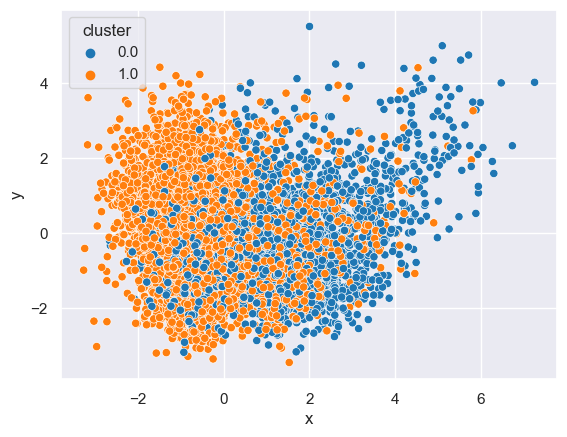

In [162]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = projection_ac_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch Aggolmerative Clustering with UMAP

In [163]:
#Creating copy of dataframe for modeling
gs_ac_umap_df = rec_df.copy().select_dtypes(np.number)

In [164]:
#Checking output
gs_ac_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [165]:
#Creating pipeline including a scaler, umap for dimensionality reduction and agglomerative clustering
ac_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', AgglomerativeClustering())])


In [166]:
#Creating a parameter grid for the gridsearch to create models with
ac_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__affinity':['euclidean', 'l1', 'l2', 'manhattan', 'cosine', 'precomputed'],
                        }


In [167]:
#Inputting pipeline, parameter grid, custom scorer and removing cv in gridsearch
ac_gs_umap = GridSearchCV(estimator= ac_pipe_gs_umap, 
                              param_grid = ac_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [168]:
#Initialzing the gridsearch 
ac_gs_umap.fit(gs_ac_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', AgglomerativeClustering())]),
             param_grid={'model__affinity': ['euclidean', 'l1', 'l2',
                                             'manhattan', 'cosine',
                                             'precomputed'],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [169]:
#Checking the best parameter from the gridsearch
ac_gs_umap.best_params_

{'model__affinity': 'euclidean',
 'model__n_clusters': 7,
 'umap__min_dist': 0.5,
 'umap__n_neighbors': 2}

In [170]:
#Checking the best score in the gridsearch
ac_gs_umap.best_score_

-0.06667446009818341

In [171]:
#Checking if custom scorer was used
ac_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [172]:
#Predicting clusters using the model's fit_predict function
preds_ac_umap = ac_gs_umap.best_estimator_.named_steps['model'].fit_predict(gs_ac_umap_df)

In [173]:
#Checking output
preds_ac_umap

array([1, 6, 2, ..., 3, 1, 1], dtype=int64)

In [174]:
#Attaching the predictions to the dataframe
gs_ac_umap_df['cluster'] = preds_ac_umap

In [175]:
gs_ac_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


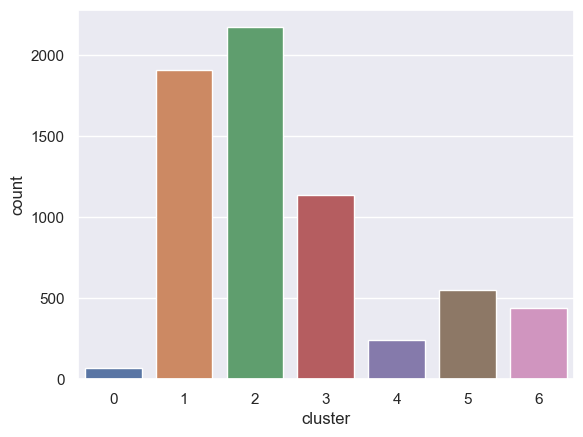

In [176]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_ac_umap_df, x = 'cluster');

In [177]:
#Checking counts of songs per cluster
gs_ac_umap_df['cluster'].value_counts()

2    2169
1    1908
3    1135
5     553
6     439
4     242
0      67
Name: cluster, dtype: int64

In [178]:
#Using umap step to provide 2 dimensional data for visualization
ac_gs_umap_db = ac_gs_umap.best_estimator_.named_steps['umap'].transform(gs_ac_umap_df.drop('cluster', axis=1))

In [179]:
#Creating dataframe for umap output
ac_gs_umap_df = pd.DataFrame(ac_gs_umap_db, columns=['umap_1', 'umap_2'])

In [180]:
#Checking for missing information
ac_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [181]:
#Adding predictions to umap dataframe
ac_gs_umap_df['cluster'] = gs_ac_umap_df['cluster']

In [182]:
#Checking output
ac_gs_umap_df

,umap_1,umap_2,cluster
0,-1.932019,17.822243,1.0
1,-1.801097,17.796728,6.0
2,-1.807104,17.780169,2.0
3,-1.873912,17.847668,5.0
4,-1.730776,17.740009,1.0
...,...,...,...
6508,-1.712707,17.732477,2.0
6509,-1.764075,17.842949,6.0
6510,-1.774547,17.804890,1.0
6511,-1.795812,17.787580,3.0


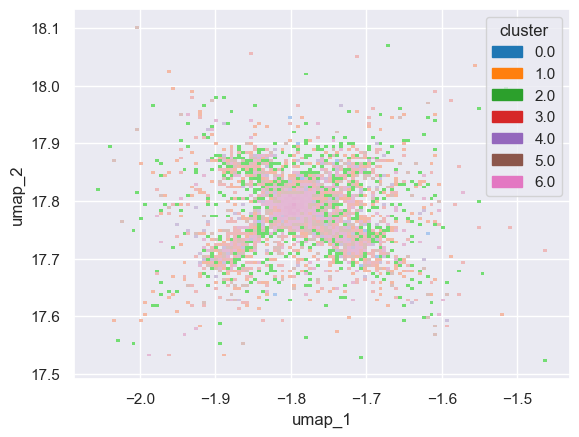

In [183]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = ac_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [184]:
#Visualizing clusters using plotly
px.scatter(ac_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch Aggolmerative Clustering with PCA

In [185]:
#Creating a copy of the dataframe for modeling
gs_ac_pca_df = rec_df.copy().select_dtypes(np.number)

In [186]:
#Checking output
gs_ac_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [187]:
#Creating a pipeline using a scaler, PCA for dimensionality reduction and agglomerative clustering
ac_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', AgglomerativeClustering())])

In [188]:
#Creating a parameter grid for gridsearch to create models based off of
ac_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                  }


In [189]:
#Inputting pipeline, parameter grid, custom scorer and removing cv in gridsearch
ac_gs_pca = GridSearchCV(estimator=ac_pipe_gs_pca,
                             param_grid = ac_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [190]:
#Initializing model
ac_gs_pca.fit(gs_ac_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', AgglomerativeClustering())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [191]:
#Predicting clusters using the model's fit_predict function
ac_pca_preds = ac_gs_pca.best_estimator_.named_steps['model'].fit_predict(gs_ac_pca_df)

In [192]:
#Adding predictions to the dataframe
gs_ac_pca_df['cluster'] = ac_pca_preds

In [193]:
#Checking output
gs_ac_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


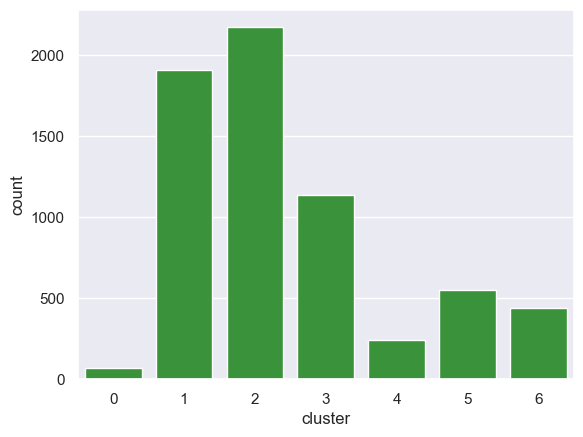

In [194]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_ac_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [195]:
#Checking unsupervised learning metrics
clustering_metrics(gs_ac_pca_df.drop('cluster', axis=1), ac_pca_preds)

Silhouette Score:  0.5044593226187063 

 -------------------------- 


Calinski Harabasz Score:  13125.09891745783  

 -------------------------- 


Davies Bouldin Score:  0.5575395794858196 

 -------------------------- 




In [196]:
#Checking the best parameters from the gridseardch
ac_gs_pca.best_params_

{'model__n_clusters': 7, 'pca__n_components': 13}

In [197]:
#Checking best score from gridsearch
ac_gs_pca.best_score_

-0.10026954882713847

In [198]:
#Checking if gridsearch used custom scorer 
ac_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [199]:
#Created PCA pipeline to turn data into 2 dimensions for visualization
ac_pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])

#Creating dataframe for PCA outputs
songs_ac_pca = gs_ac_pca_df 
song_embedding_ac_pca = ac_pca_pipeline.fit_transform(songs_ac_pca)
projection_ac_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_ac_pca)

#Adding artist, track name and predictions to the dataframe
projection_ac_pca['artist'] = rec_df['artist']
projection_ac_pca['title'] = rec_df['track_name']
projection_ac_pca['cluster'] = gs_ac_pca_df['cluster']

In [200]:
#Checking output
projection_ac_pca

,x,y,artist,title,cluster
0,-0.832629,-0.483586,Bon Jovi,Livin' On A Prayer,1.0
1,-0.472536,2.535121,Bon Jovi,Wanted Dead Or Alive,6.0
2,0.808558,0.352255,Queen,We Are The Champions - Remastered 2011,2.0
3,0.584534,-1.552969,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.231319,-0.512475,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-0.776984,-1.325130,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,0.587147,-2.554922,N.W.A.,Gangsta Gangsta,6.0
6510,-1.732559,-1.461483,Various Artists,Rollin' With My Homies,1.0
6511,-2.070643,-1.832836,Nas,N.Y. State of Mind,3.0


In [201]:
#Visualizing clusters using plotly
plot_clusters(projection_ac_pca, 'x', 'y')

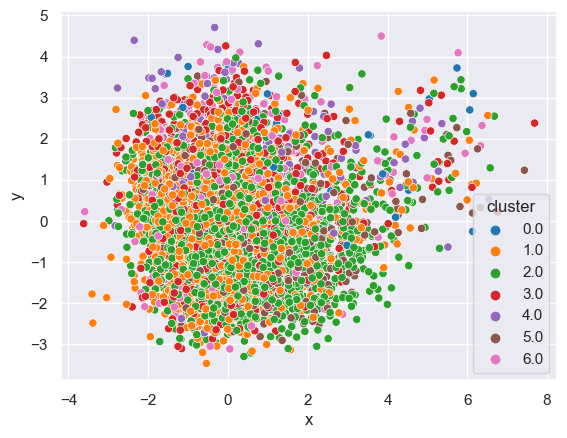

In [202]:
#Visualizing clusters using seaborn
sns.scatterplot(data = projection_ac_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>Birch<u/>

### Baseline Birch Clustering with no dimensionality reduction

In [203]:
#Creating baseline pipeline using a scaler and birch
birch_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                ('model', Birch())])

In [204]:
#Creating a copy of the dataframe for modeling
birch_base_song_df = rec_df.select_dtypes(np.number)
birch_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [205]:
#Using the fit_predict method to generate predictions for clusters
birch_song_base_labels = birch_base_cluster_pipeline.fit_predict(birch_base_song_df)

In [206]:
#Adding predictions, artists and track names to the dataframe
birch_base_song_df['cluster_label'] = birch_song_base_labels
birch_base_song_df['artist'] = rec_df['artist']
birch_base_song_df['track_name'] = rec_df['track_name']

In [207]:
#Checking output
birch_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [208]:
#Checking unsupervised learning metrics
clustering_metrics(birch_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), birch_song_base_labels)

Silhouette Score:  -0.08702959262029554 

 -------------------------- 


Calinski Harabasz Score:  38.554239474990744  

 -------------------------- 


Davies Bouldin Score:  9.457742584876014 

 -------------------------- 




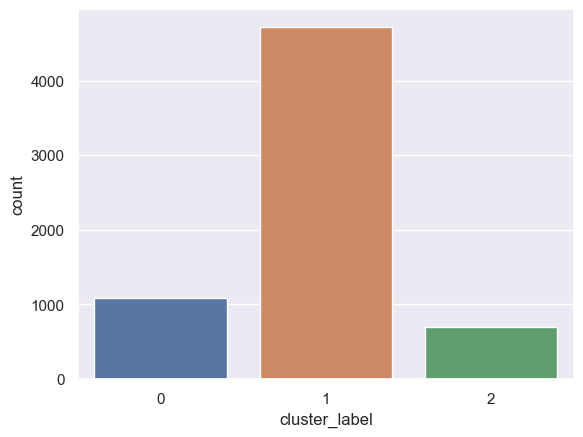

In [209]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=birch_base_song_df, x = 'cluster_label');

In [210]:
#Checking counts of songs per cluster
birch_base_song_df['cluster_label'].value_counts()

1    4721
0    1092
2     700
Name: cluster_label, dtype: int64

In [211]:
#Creating 2 dimensians with the data using PCA for visualization
projection_birch_base = PCA_pipeline(StandardScaler(), birch_base_song_df)

In [212]:
#Visualizing clusters using plotly
plot_clusters(projection_birch_base, 'x', 'y')

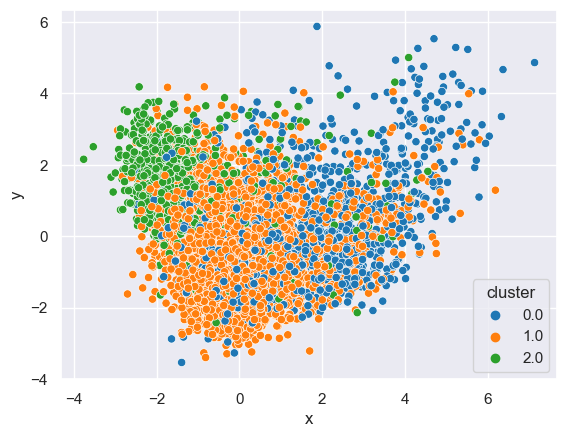

In [213]:
#Visualizing clusters using seaborn
sns.scatterplot(data = projection_birch_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline Birch Clustering with UMAP

In [214]:
#Creating baseline pipeline with a scaler, umap for dimensionality reduction and birch
birch_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', Birch())])

In [215]:
#Creating a copy of the dataframe for modeling
birch_umap_song_df = rec_df.select_dtypes(np.number)
birch_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [216]:
#Using fit_predict function to generate cluster predictions
birch_umap_song_cluster_labels = birch_cluster_pipeline.fit_predict(birch_umap_song_df)

In [217]:
#Adding predictions to dataframe
birch_umap_song_df['cluster_label'] = birch_umap_song_cluster_labels

In [218]:
#Checking output
birch_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,2
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,2
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


In [219]:
#Checking unsupervised learning metrics
clustering_metrics(birch_umap_song_df.drop('cluster_label', axis=1), birch_umap_song_cluster_labels)

Silhouette Score:  -0.02004462520118383 

 -------------------------- 


Calinski Harabasz Score:  8.029135331932547  

 -------------------------- 


Davies Bouldin Score:  30.444639290782945 

 -------------------------- 




In [220]:
#Going into pipeline to get values of UMAP for visualization
birch_umap_db = birch_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [221]:
#Creating dataframe using umap output
birch_umap_df = pd.DataFrame(birch_umap_db, columns=['umap_1', 'umap_2'])

In [222]:
#Adding clusters to umap dataframe
birch_umap_df['cluster'] = birch_umap_song_df['cluster_label']

In [223]:
#Checking output
birch_umap_df

,umap_1,umap_2,cluster
0,10.406441,9.858635,0.0
1,10.416002,9.858784,0.0
2,10.431747,9.833695,2.0
3,10.414034,9.833710,0.0
4,10.422783,9.821540,2.0
...,...,...,...
6508,10.413245,9.804479,0.0
6509,10.427170,9.832871,2.0
6510,10.425718,9.829735,0.0
6511,10.383011,9.785863,2.0


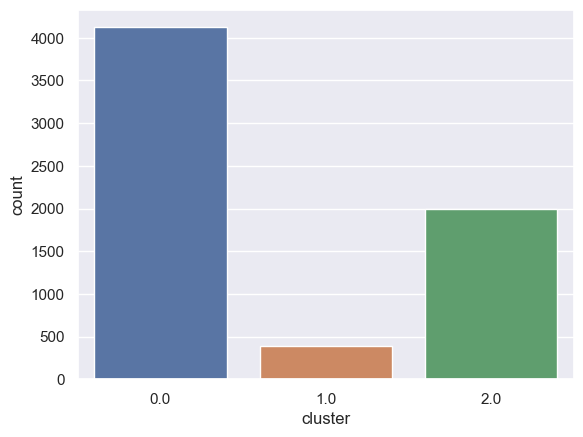

In [224]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=birch_umap_df, x = 'cluster');

In [225]:
#Checking counts of songs per cluster 
birch_umap_df['cluster'].value_counts()

0.0    4123
2.0    1995
1.0     394
Name: cluster, dtype: int64

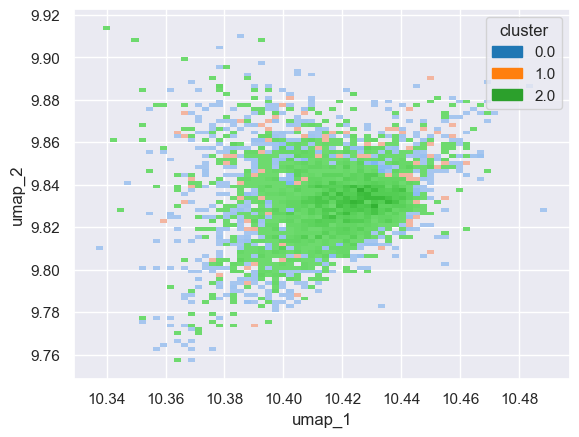

In [226]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = birch_umap_df, hue = 'cluster', palette = 'tab10');

In [227]:
#Visualizing clusters using plotly
px.scatter(birch_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

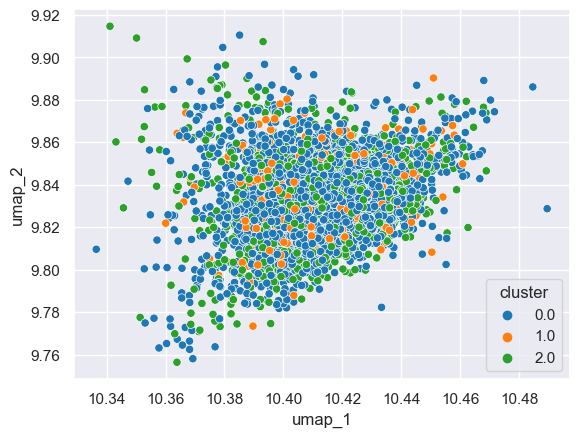

In [228]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = birch_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline Birch Clustering with PCA

In [229]:
#Creating a copy of the dataframe for modeling
pca_birch_df = rec_df.copy()

In [230]:
#Checking output
pca_birch_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [231]:
#Creating pipeline using a scaler, PCA for dimensionality reduction and birch
birch_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', Birch())])

In [232]:
#Using fit_predict function to generate cluster predictions
pca_birch_preds = birch_pca_cluster_pipeline.fit_predict(pca_birch_df.select_dtypes(np.number))

In [233]:
#Checking output
pca_birch_preds

array([1, 2, 0, ..., 1, 1, 0], dtype=int64)

In [234]:
#Checking components of the output
birch_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [235]:
#Checking total variance explained
birch_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [236]:
#Adding predictions to the dataframe
pca_birch_df['cluster_label'] = pca_birch_preds

In [237]:
#Checking output
pca_birch_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,2
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [238]:
#Using PCA to turn data into 3 dimensions for visualization
projection_birch_pca = PCA_pipeline(StandardScaler(), pca_birch_df)

In [239]:
#Checking output
projection_birch_pca

,x,y,artist,title,cluster
0,-0.360667,-0.588913,Bon Jovi,Livin' On A Prayer,1.0
1,-1.715727,1.739898,Bon Jovi,Wanted Dead Or Alive,2.0
2,1.464790,0.621339,Queen,We Are The Champions - Remastered 2011,0.0
3,1.215823,-1.633096,Queen,We Will Rock You - Remastered 2011,1.0
4,-1.398850,-0.690242,Bon Jovi,You Give Love A Bad Name,2.0
...,...,...,...,...,...
6508,0.086994,-2.215249,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,1.0
6509,1.450108,-1.979829,N.W.A.,Gangsta Gangsta,1.0
6510,-0.638838,-2.269247,Various Artists,Rollin' With My Homies,1.0
6511,-0.710317,-2.492459,Nas,N.Y. State of Mind,1.0


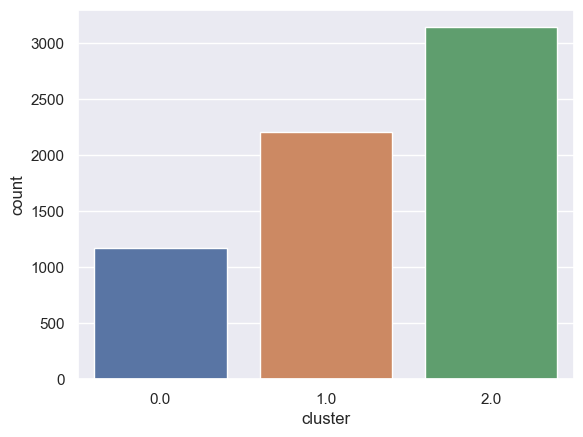

In [240]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=projection_birch_pca, x = 'cluster');

In [241]:
#Checking counts of songs per cluster
projection_birch_pca['cluster'].value_counts()

2.0    3138
1.0    2208
0.0    1166
Name: cluster, dtype: int64

In [242]:
#Visualizing clusters using plotly
plot_clusters(projection_birch_pca, 'x', 'y')

In [243]:
#Checking unsupervised learning metrics
clustering_metrics(pca_birch_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_birch_preds)

Silhouette Score:  -0.04414056710422598 

 -------------------------- 


Calinski Harabasz Score:  125.00826067917471  

 -------------------------- 


Davies Bouldin Score:  15.422346271194343 

 -------------------------- 




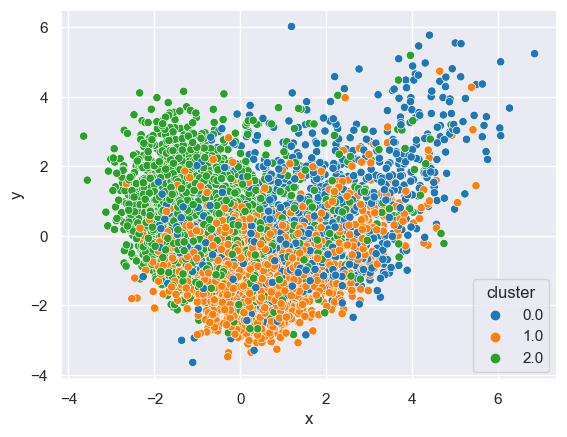

In [244]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = projection_birch_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch Birch Clustering with UMAP

In [245]:
#Creating a copy of the dataframe for modeling
gs_birch_umap_df = rec_df.copy().select_dtypes(np.number)

In [246]:
#Checking output
gs_birch_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [247]:
#Creating a pipeline using a scaler, umap for dimensionality reduction and birch
birch_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', Birch())])


In [248]:
#Creating a parameter grid for gridsearch to find the best model
birch_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__threshold':[0.01, 0.1, 0.5, 0.8],
                        }


In [249]:
#Inputting pipeline, parameter grid, custom scorer and removing cv from gridsearch
birch_gs_umap = GridSearchCV(estimator= birch_pipe_gs_umap, 
                              param_grid = birch_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [250]:
#Fitting model
birch_gs_umap.fit(gs_birch_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!



GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()), ('model', Birch())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__threshold': [0.01, 0.1, 0.5, 0.8],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [251]:
#Checking best parameters from gridsearch
birch_gs_umap.best_params_

{'model__n_clusters': 7,
 'model__threshold': 0.5,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [252]:
#Checking the best score from the gridsearch
birch_gs_umap.best_score_

-0.051835859080109334

In [253]:
#Checking if gridsearch used custom scorer
birch_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [254]:
#Using fit_predict function to generate cluster predictions
preds_birch_umap = birch_gs_umap.predict(gs_birch_umap_df)

In [255]:
#Checking output
preds_birch_umap

array([2, 3, 4, ..., 0, 6, 3], dtype=int64)

In [256]:
#Adding predictions to dataframe
gs_birch_umap_df['cluster'] = preds_birch_umap

In [257]:
#Checking output
gs_birch_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,2
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,3
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,2
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,5
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,6


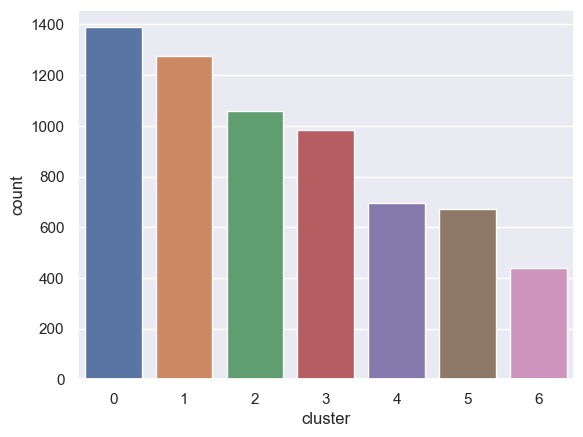

In [258]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_birch_umap_df, x = 'cluster');

In [259]:
#Checking counts of songs per cluster
gs_birch_umap_df['cluster'].value_counts()

0    1389
1    1276
2    1058
3     984
4     696
5     670
6     440
Name: cluster, dtype: int64

In [260]:
#Using umap step to provide 2 dimensional data for visualization
birch_gs_umap_db = birch_gs_umap.best_estimator_.named_steps['umap'].transform(gs_birch_umap_df.drop('cluster', axis=1))

In [261]:
#Creating a dataframe with umap information
birch_gs_umap_df = pd.DataFrame(birch_gs_umap_db, columns=['umap_1', 'umap_2'])

In [262]:
#Checking for missing data
birch_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [263]:
#Adding predictions to umap dataframe
birch_gs_umap_df['cluster'] = gs_birch_umap_df['cluster']

In [264]:
#Checking information
birch_gs_umap_df

,umap_1,umap_2,cluster
0,-2.977440,6.438560,2.0
1,-2.784504,6.572686,3.0
2,-2.793999,6.299238,4.0
3,-2.760714,6.528329,2.0
4,-2.985440,6.548569,4.0
...,...,...,...
6508,-2.929631,6.334875,5.0
6509,-2.906059,6.466679,5.0
6510,-2.871757,6.482018,0.0
6511,-2.777643,6.529293,0.0


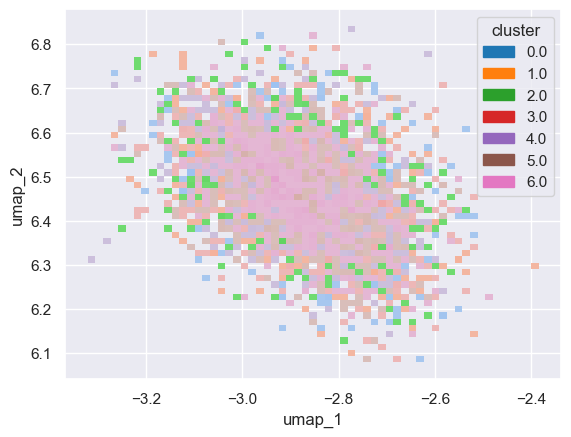

In [265]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = birch_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [266]:
#Visualizing clusters using plotly
px.scatter(birch_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch Birch Clustering with PCA

In [267]:
#Creating a copy of the dataframe for modeling
gs_birch_pca_df = rec_df.copy().select_dtypes(np.number)

In [268]:
gs_birch_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [269]:
#Creating a baseline pipeline using a scaler, PCA for dimensionality reduction and birch
birch_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', Birch())])

In [270]:
#Creating a parameter grid for gridsearch to find the best model
birch_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__threshold':[0.01, 0.1, 0.5, 0.8]
                  }


In [271]:
#Inputting pipeline, parameter grid, custom scorer and removing cv for gridsearch
birch_gs_pca = GridSearchCV(estimator=birch_pipe_gs_pca,
                             param_grid = birch_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [272]:
#Fitting models
birch_gs_pca.fit(gs_birch_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()), ('model', Birch())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__threshold': [0.01, 0.1, 0.5, 0.8],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [273]:
#Generating cluster predictions
birch_pca_preds = birch_gs_pca.predict(gs_birch_pca_df)

In [274]:
#Adding predictions to dataframe
gs_birch_pca_df['cluster'] = birch_pca_preds

In [275]:
#Checking output
gs_birch_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,3
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,5
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,2
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,5
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,5


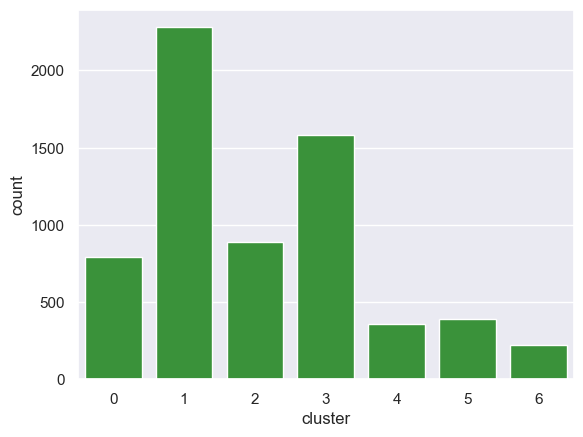

In [276]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_birch_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [277]:
#Checking unsupervised learning metrics
clustering_metrics(gs_birch_pca_df.drop('cluster', axis=1), birch_pca_preds)

Silhouette Score:  -0.08052380282769846 

 -------------------------- 


Calinski Harabasz Score:  86.34183358619052  

 -------------------------- 


Davies Bouldin Score:  63.751815394798484 

 -------------------------- 




In [278]:
#Checking best parameters from gridsearch
birch_gs_pca.best_params_

{'model__n_clusters': 7, 'model__threshold': 0.1, 'pca__n_components': 13}

In [279]:
#Checking best score from gridsearch
birch_gs_pca.best_score_

-0.08052380282769846

In [280]:
#Checking if gridsearch used custom function
birch_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [281]:
#Creating PCA pipeline to reduce the dimensions to 2 for visualization
birch_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

#Creating dataframe for PCA output
songs_birch_pca = gs_birch_pca_df 
song_embedding_birch_pca = birch_pca_pipeline.fit_transform(songs_birch_pca)
projection_birch_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_birch_pca)

#Adding artist, track and predictions to the dataframe
projection_birch_pca['artist'] = rec_df['artist']
projection_birch_pca['title'] = rec_df['track_name']
projection_birch_pca['cluster'] = gs_birch_pca_df['cluster']

In [282]:
#Checking output
projection_birch_pca

,x,y,artist,title,cluster
0,-0.486655,0.693487,Bon Jovi,Livin' On A Prayer,1.0
1,-0.279625,2.297094,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.601356,-0.620451,Queen,We Are The Champions - Remastered 2011,3.0
3,-0.196437,-2.714236,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.265742,-0.351194,Bon Jovi,You Give Love A Bad Name,3.0
...,...,...,...,...,...
6508,-1.898190,-3.221537,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,0.537375,-1.614396,N.W.A.,Gangsta Gangsta,5.0
6510,-2.466584,-2.435922,Various Artists,Rollin' With My Homies,2.0
6511,-2.776178,-2.748560,Nas,N.Y. State of Mind,5.0


In [283]:
#Visualizing clusters using plotly
plot_clusters(projection_birch_pca, 'x', 'y')

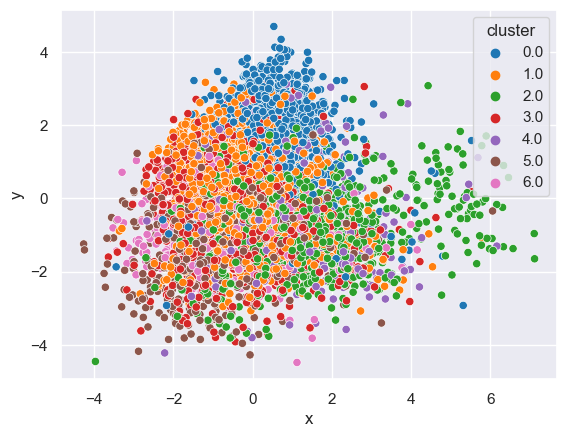

In [284]:
#visualizing clusters using seaborn
sns.scatterplot(data = projection_birch_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>MiniBatchKMeans<u/>

### Baseline MiniBatchKMeans with no dimensionality reduction

In [285]:
#Setting up pipeline to scale data and perform minibatch kmeans on the data
mbkmeans_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('model', MiniBatchKMeans())])

In [286]:
#Creating a copy DataFrame for modeling
mbkmeans_base_song_df = rec_df.select_dtypes(np.number)
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [287]:
#Predicting clusters based on the DataFrame
mbkmeans_song_base_labels = mbkmeans_base_cluster_pipeline.fit_predict(mbkmeans_base_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [288]:
#Adding cluster outputs, artist and track names to the DataFrame
mbkmeans_base_song_df['cluster_label'] = mbkmeans_song_base_labels
mbkmeans_base_song_df['artist'] = rec_df['artist']
mbkmeans_base_song_df['track_name'] = rec_df['track_name']

In [289]:
#Checking columns
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,7,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,7,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,3,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,3,Nas,Nas Is Like


In [290]:
#Checking unsupervised learning metrics
clustering_metrics(mbkmeans_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), mbkmeans_song_base_labels)

Silhouette Score:  -0.14047322188649464 

 -------------------------- 


Calinski Harabasz Score:  123.60844930571699  

 -------------------------- 


Davies Bouldin Score:  66.99461030118411 

 -------------------------- 




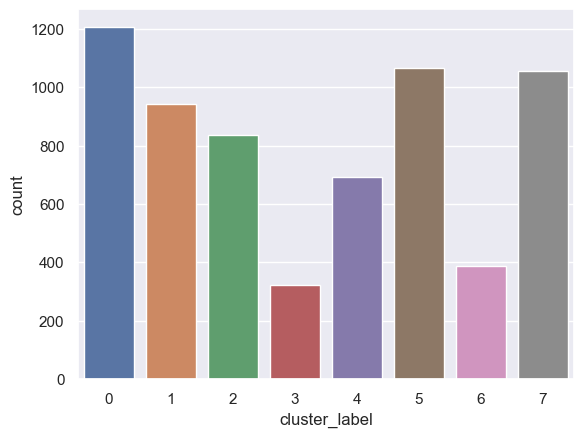

In [291]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=mbkmeans_base_song_df, x = 'cluster_label');

In [292]:
#Checking how many songs are assigned to each cluster
mbkmeans_base_song_df['cluster_label'].value_counts()

0    1207
5    1066
7    1057
1     944
2     838
4     692
6     387
3     322
Name: cluster_label, dtype: int64

In [293]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_mbkmeans_base = PCA_pipeline(StandardScaler(), mbkmeans_base_song_df)

In [294]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_mbkmeans_base, 'x', 'y')

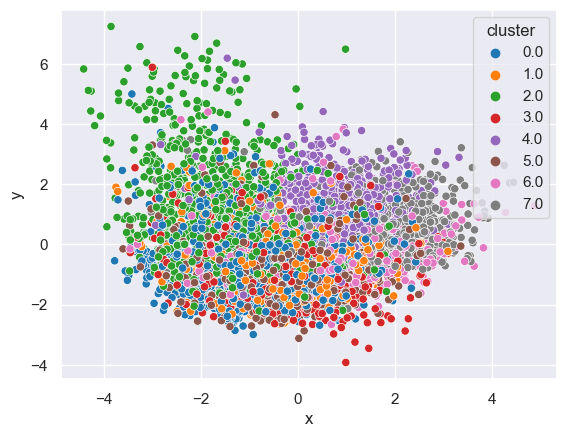

In [295]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_mbkmeans_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline MiniBatchKMeans with UMAP

In [296]:
#Creating baseline pipeline using a scaler, umap for dimensionality reduction and Minibatch Kmeans
mbkmeans_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', MiniBatchKMeans())])

In [297]:
#Creating a copy of the dataframe for modeling
mbkmeans_umap_song_df = rec_df.select_dtypes(np.number)
mbkmeans_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [298]:
#Using fit_predict function to generate cluster predictions
mbkmeans_umap_song_cluster_labels = mbkmeans_cluster_pipeline.fit_predict(mbkmeans_umap_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [299]:
#Adding predictions to the dataframe
mbkmeans_umap_song_df['cluster_label'] = mbkmeans_umap_song_cluster_labels

In [300]:
#Checking output
mbkmeans_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,5
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [301]:
#Checking unsupervised learning metrics
clustering_metrics(mbkmeans_umap_song_df.drop('cluster_label', axis=1), mbkmeans_umap_song_cluster_labels)

Silhouette Score:  -0.1256652095593403 

 -------------------------- 


Calinski Harabasz Score:  66.85126657789107  

 -------------------------- 


Davies Bouldin Score:  346.4779070027292 

 -------------------------- 




In [302]:
#Going into pipeline to get values of UMAP for visualization
mbkmeans_umap_db = mbkmeans_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [303]:
#Creating a dataframe for umap output
mbkmeans_umap_df = pd.DataFrame(mbkmeans_umap_db, columns=['umap_1', 'umap_2'])

In [304]:
#Adding predictions to umap dataframe
mbkmeans_umap_df['cluster'] = mbkmeans_umap_song_df['cluster_label']

In [305]:
#Checking output
mbkmeans_umap_df

,umap_1,umap_2,cluster
0,12.606101,12.189342,0.0
1,12.619769,12.152204,0.0
2,12.607855,12.158023,5.0
3,12.587074,12.151756,4.0
4,12.602888,12.182817,5.0
...,...,...,...
6508,12.618879,12.192704,4.0
6509,12.627195,12.207226,1.0
6510,12.610509,12.177409,4.0
6511,12.617234,12.180203,1.0


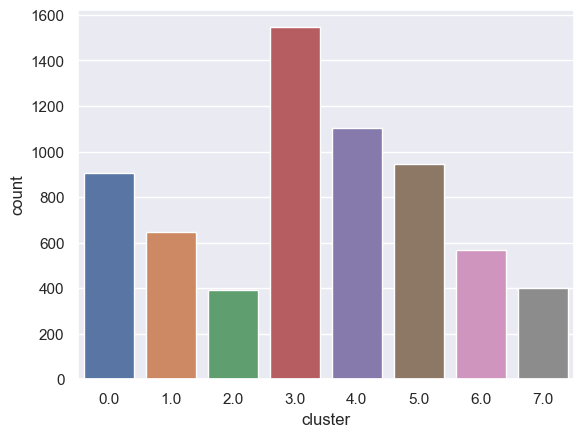

In [306]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=mbkmeans_umap_df, x = 'cluster');

In [307]:
#Checking counts of songs per cluster
mbkmeans_umap_df['cluster'].value_counts()

3.0    1546
4.0    1104
5.0     946
0.0     907
1.0     646
6.0     568
7.0     402
2.0     393
Name: cluster, dtype: int64

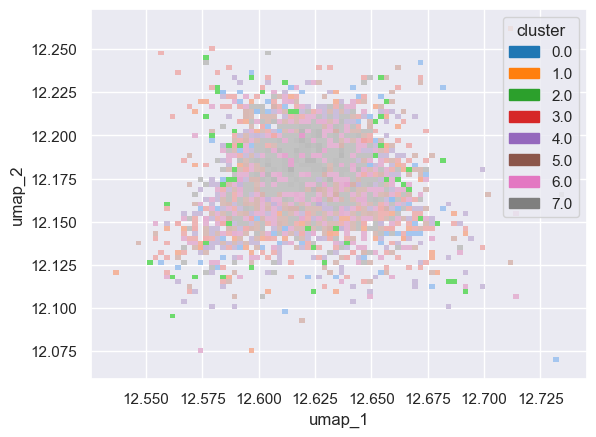

In [308]:
#Visualzing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = mbkmeans_umap_df, hue = 'cluster', palette = 'tab10');

In [309]:
#Visualizing clusters using plotly
px.scatter(mbkmeans_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

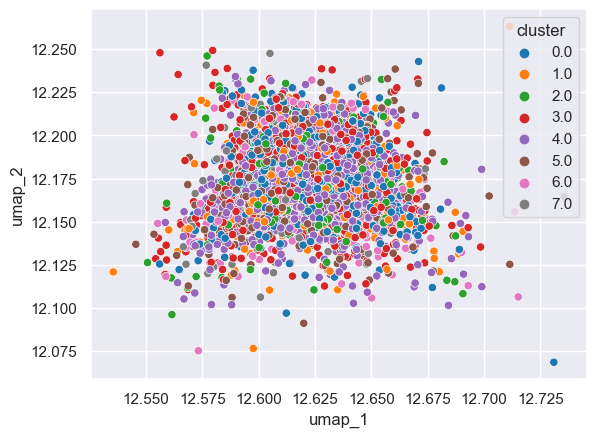

In [310]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = mbkmeans_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline MiniBatchKMeans with PCA

In [311]:
#Creating a copy of the dataframe for modeling
pca_mbkmeans_df = rec_df.copy()

In [312]:
#Checking output
pca_mbkmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [313]:
#Creating a pipeline using a scaler, PCA for dimensionality reduction and Minibatch Kmeans
mbkmeans_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', MiniBatchKMeans())])

In [314]:
#Using fit_predict function to generate cluster predictions
pca_mbkmeans_preds = mbkmeans_pca_cluster_pipeline.fit_predict(pca_mbkmeans_df.select_dtypes(np.number))

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [315]:
#Checking output
pca_mbkmeans_preds

array([0, 1, 2, ..., 2, 2, 6])

In [316]:
#Checking PCA components 
mbkmeans_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [317]:
#Checking total variance explained
mbkmeans_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [318]:
#Adding predictions to the dataframe
pca_mbkmeans_df['cluster_label'] = pca_mbkmeans_preds

In [319]:
#Checking output
pca_mbkmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,3
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,2
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,3
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,2
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


In [320]:
#Using PCA pipeline to reduce data to 2 dimensions for visualization
projection_mbkmeans_pca = PCA_pipeline(StandardScaler(), pca_mbkmeans_df)

In [321]:
#Checking output
projection_mbkmeans_pca

,x,y,artist,title,cluster
0,-1.328167,-0.441999,Bon Jovi,Livin' On A Prayer,0.0
1,-1.738488,1.783919,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.508491,0.711659,Queen,We Are The Champions - Remastered 2011,2.0
3,0.828135,-1.584639,Queen,We Will Rock You - Remastered 2011,3.0
4,-0.353849,-0.820460,Bon Jovi,You Give Love A Bad Name,5.0
...,...,...,...,...,...
6508,-0.520801,-2.128592,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,3.0
6509,1.195935,-1.968763,N.W.A.,Gangsta Gangsta,2.0
6510,-1.123364,-2.200538,Various Artists,Rollin' With My Homies,3.0
6511,-1.293835,-2.403101,Nas,N.Y. State of Mind,2.0


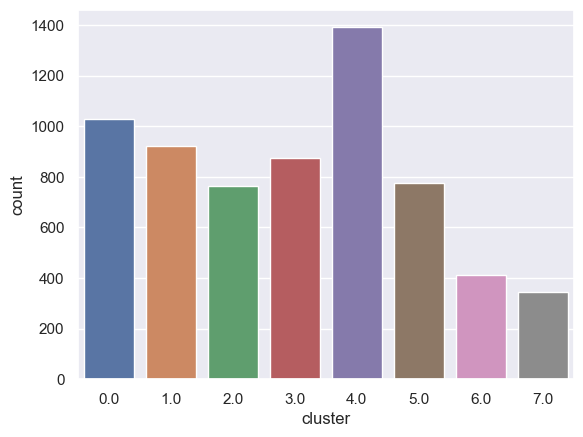

In [322]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=projection_mbkmeans_pca, x = 'cluster');

In [323]:
#Checking counts of songs per cluster
projection_mbkmeans_pca['cluster'].value_counts()

4.0    1391
0.0    1030
1.0     921
3.0     875
5.0     776
2.0     763
6.0     413
7.0     343
Name: cluster, dtype: int64

In [324]:
#visualizing clusters using plotly
plot_clusters(projection_mbkmeans_pca, 'x', 'y')

In [325]:
#Checking unsupervised learning metrics
clustering_metrics(projection_mbkmeans_pca.select_dtypes(np.number).drop('cluster', axis=1), pca_mbkmeans_preds)

Silhouette Score:  0.06486605443112133 

 -------------------------- 


Calinski Harabasz Score:  1884.6010219444713  

 -------------------------- 


Davies Bouldin Score:  3.191191914093554 

 -------------------------- 




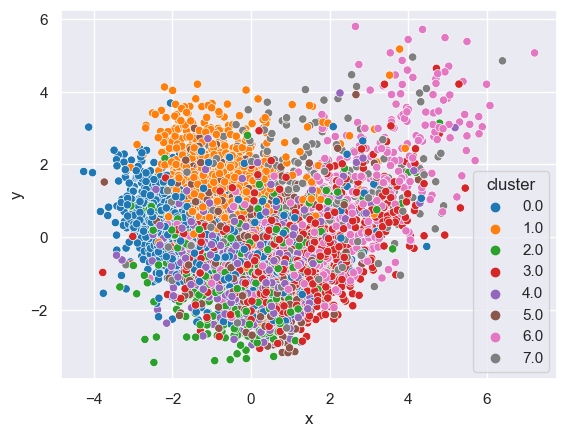

In [326]:
#Visualizing clusters using seaborn
sns.scatterplot(data = projection_mbkmeans_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch MiniBatchKMeans with UMAP

In [327]:
#Creating a copy of the dataframe for modeling
gs_mbkmeans_umap_df = rec_df.copy().select_dtypes(np.number)

In [328]:
#Checking output
gs_mbkmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [329]:
#Creating pipeline with a scaler, umap for dimensionality reduction and Minibatch Kmeans
mbkmeans_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', MiniBatchKMeans())])


In [330]:
#Creating a parameter grid for gridsearch to find the best model
mbkmeans_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__max_iter':[100, 500, 1000],
                      'model__batch_size':[512, 1024, 2048]
                        }


In [331]:
#Inputting pipeline, parameter grid, custom scorer and removing cv for gridsearch
mbkmeans_gs_umap = GridSearchCV(estimator= mbkmeans_pipe_gs_umap, 
                              param_grid = mbkmeans_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [332]:
#Fitting models
mbkmeans_gs_umap.fit(gs_mbkmeans_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', MiniBatchKMeans())]),
             param_grid={'model__batch_size': [512, 1024, 2048],
                         'model__max_iter': [100, 500, 1000],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [333]:
#Checking the best parameters from the gridsearch
mbkmeans_gs_umap.best_params_

{'model__batch_size': 2048,
 'model__max_iter': 1000,
 'model__n_clusters': 7,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [334]:
#Checking the best score from the gridsearch
mbkmeans_gs_umap.best_score_

-0.04891443927137089

In [335]:
#Checking if gridsearch used custom scorer
mbkmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [336]:
#Using predict to generate cluster predictions
preds_mbkmeans_umap = mbkmeans_gs_umap.predict(gs_mbkmeans_umap_df)

In [337]:
#hecking outputs
preds_mbkmeans_umap

array([6, 4, 1, ..., 1, 3, 6])

In [338]:
#Adding predictions to the dataframe
gs_mbkmeans_umap_df['cluster'] = preds_mbkmeans_umap

In [339]:
#Checking output
gs_mbkmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,3
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,3


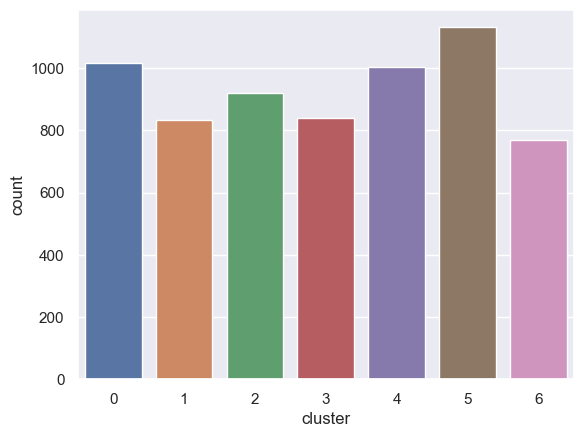

In [340]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_mbkmeans_umap_df, x = 'cluster');

In [341]:
#Checking counts of songs per cluster
gs_mbkmeans_umap_df['cluster'].value_counts()

5    1131
0    1016
4    1004
2     921
3     841
1     832
6     768
Name: cluster, dtype: int64

In [342]:
#Using umap step to provide 2 dimensional data for visualization
mbkmeans_gs_umap_db = mbkmeans_gs_umap.best_estimator_.named_steps['umap'].transform(gs_mbkmeans_umap_df.drop('cluster', axis=1))

In [343]:
#Creating a dataframe using umap information
mbkmeans_gs_umap_df = pd.DataFrame(mbkmeans_gs_umap_db, columns=['umap_1', 'umap_2'])

In [344]:
#Checking for missing infomation
mbkmeans_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [345]:
#Adding cluster predictions to dataframe
mbkmeans_gs_umap_df['cluster'] = gs_mbkmeans_umap_df['cluster']

In [346]:
mbkmeans_gs_umap_df

,umap_1,umap_2,cluster
0,0.748552,11.959525,6.0
1,-1.267195,13.523550,4.0
2,2.174357,11.606180,1.0
3,-1.460949,13.093472,3.0
4,5.036394,9.639515,4.0
...,...,...,...
6508,-2.203975,13.427528,5.0
6509,-1.000433,13.168278,4.0
6510,-0.461556,12.824342,5.0
6511,5.099425,9.568192,1.0


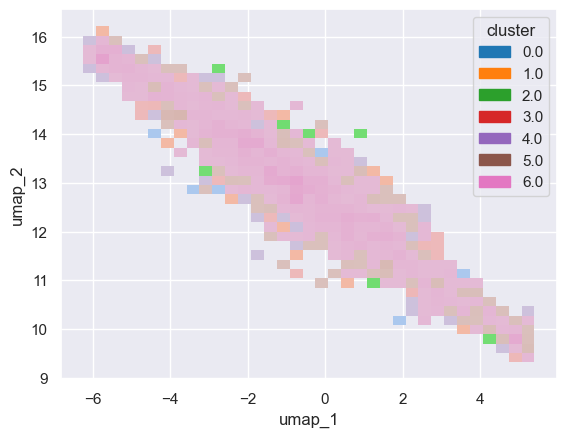

In [347]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = mbkmeans_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [348]:
#Visualizing clusters using plotly
px.scatter(mbkmeans_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch MiniBatchKMeans with PCA

In [349]:
#Creating a copy of the dataframe for modeling
gs_mbkmeans_pca_df = rec_df.copy().select_dtypes(np.number)

In [350]:
#Checking output
gs_mbkmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [351]:
#Creating a pipeline using a scaler, pca for dimensionality reduction and MiniBatchKmeans
mbkmeans_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', MiniBatchKMeans())])

In [352]:
#Creating a parameter grid to find the best model in gridsearch
mbkmeans_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__max_iter':[100, 500, 1000, 0.8],
                      'model__batch_size':[512, 1024, 2048]
                  }


In [353]:
#Inputting pipeline, parameter grid, custom scorer and removing cv for gridsearch
mbkmeans_gs_pca = GridSearchCV(estimator=mbkmeans_pipe_gs_pca,
                             param_grid = mbkmeans_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [354]:
#Fitting models
mbkmeans_gs_pca.fit(gs_mbkmeans_pca_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', MiniBatchKMeans())]),
             param_grid={'model__batch_size': [512, 1024, 2048],
                         'model__max_iter': [100, 500, 1000, 0.8],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x0000016F8BA28160>)

In [355]:
#Using predict function to generate cluster predictions
mbkmeans_pca_preds = mbkmeans_gs_pca.predict(gs_mbkmeans_pca_df)

In [356]:
#Adding predictions to the dataframe
gs_mbkmeans_pca_df['cluster'] = mbkmeans_pca_preds

In [357]:
#Checking output
gs_mbkmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,3
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,2
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,2
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


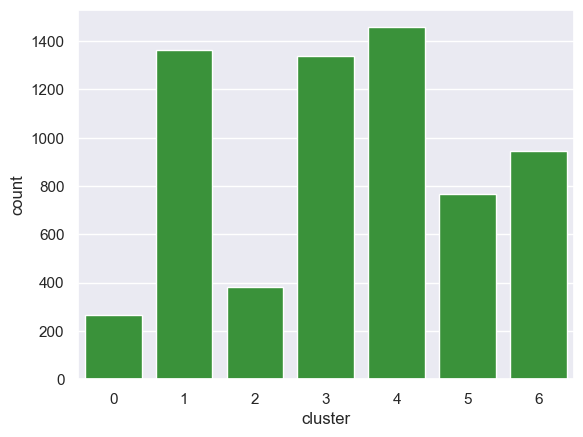

In [358]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_mbkmeans_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [359]:
#Checking unsupervised learning metrics
clustering_metrics(gs_mbkmeans_pca_df.drop('cluster', axis=1), mbkmeans_pca_preds)

Silhouette Score:  -0.12171471351789755 

 -------------------------- 


Calinski Harabasz Score:  29.504670127181665  

 -------------------------- 


Davies Bouldin Score:  26.058143685039415 

 -------------------------- 




In [360]:
#Checking best parameters from gridsearch
mbkmeans_gs_pca.best_params_

{'model__batch_size': 2048,
 'model__max_iter': 100,
 'model__n_clusters': 7,
 'pca__n_components': 13}

In [361]:
#Checking the best score from the gridsearch
mbkmeans_gs_pca.best_score_

-0.056475310789790206

In [362]:
#Checking if gridsearch used the custom scorer
mbkmeans_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [363]:
#Using PCA pipeline to create 2 dimensional data for visualization
mbkmeans_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

#Creating dataframe from PCA output
songs_mbkmeans_pca = gs_mbkmeans_pca_df 
song_embedding_mbkmeans_pca = mbkmeans_pca_pipeline.fit_transform(songs_mbkmeans_pca)
projection_mbkmeans_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_mbkmeans_pca)

#Adding artist, track name and clusters to PCA dataframe
projection_mbkmeans_pca['artist'] = rec_df['artist']
projection_mbkmeans_pca['title'] = rec_df['track_name']
projection_mbkmeans_pca['cluster'] = gs_mbkmeans_pca_df['cluster']

In [364]:
#Checking output
projection_mbkmeans_pca

,x,y,artist,title,cluster
0,-0.325674,-0.593511,Bon Jovi,Livin' On A Prayer,4.0
1,-1.751803,1.829139,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.533035,0.713794,Queen,We Are The Champions - Remastered 2011,3.0
3,0.923507,-1.621301,Queen,We Will Rock You - Remastered 2011,4.0
4,-0.868796,-0.738678,Bon Jovi,You Give Love A Bad Name,3.0
...,...,...,...,...,...
6508,-0.778068,-2.067769,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,6.0
6509,1.419746,-2.060191,N.W.A.,Gangsta Gangsta,2.0
6510,-1.406553,-2.120373,Various Artists,Rollin' With My Homies,4.0
6511,-1.602365,-2.312895,Nas,N.Y. State of Mind,2.0


In [365]:
#Visualizing clusters using plotly
plot_clusters(projection_mbkmeans_pca, 'x', 'y')

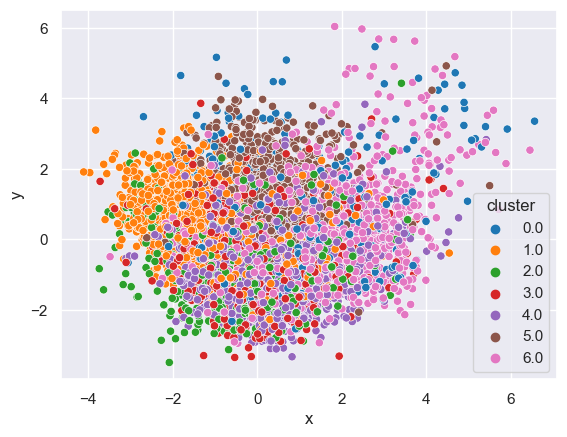

In [366]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = projection_mbkmeans_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>GaussianMixture<u/>

### Baseline GaussianMixture with no dimensionality reduction

In [367]:
#Setting up pipeline to scale data and perform Gaussian Mixture on the data
gm_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('model', GaussianMixture(n_components=7))])

In [368]:
#Creating a copy DataFrame for modeling
gm_base_song_df = rec_df.select_dtypes(np.number)
gm_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [369]:
#Predicting clusters based on the DataFrame
gm_song_base_labels = gm_base_cluster_pipeline.fit_predict(gm_base_song_df)

In [370]:
#Adding cluster outputs, artist and track names to the DataFrame
gm_base_song_df['cluster_label'] = gm_song_base_labels
gm_base_song_df['artist'] = rec_df['artist']
gm_base_song_df['track_name'] = rec_df['track_name']

In [371]:
#Checking columns
gm_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,3,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,3,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,3,Nas,Nas Is Like


In [372]:
#Checking unsupervised learning metrics
clustering_metrics(gm_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), gm_song_base_labels)

Silhouette Score:  -0.10702960728304337 

 -------------------------- 


Calinski Harabasz Score:  68.65250656355272  

 -------------------------- 


Davies Bouldin Score:  44.523764310575324 

 -------------------------- 




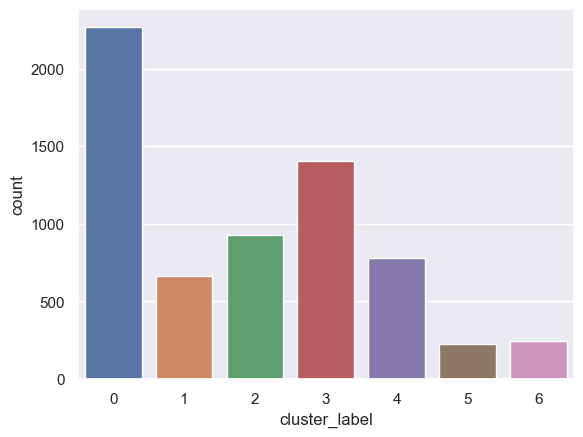

In [373]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=gm_base_song_df, x = 'cluster_label');

In [374]:
#Checking how many songs are assigned to each cluster
gm_base_song_df['cluster_label'].value_counts()

0    2269
3    1406
2     925
4     779
1     665
6     243
5     226
Name: cluster_label, dtype: int64

In [375]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_gm_base = PCA_pipeline(StandardScaler(), gm_base_song_df)

In [376]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_gm_base, 'x', 'y')

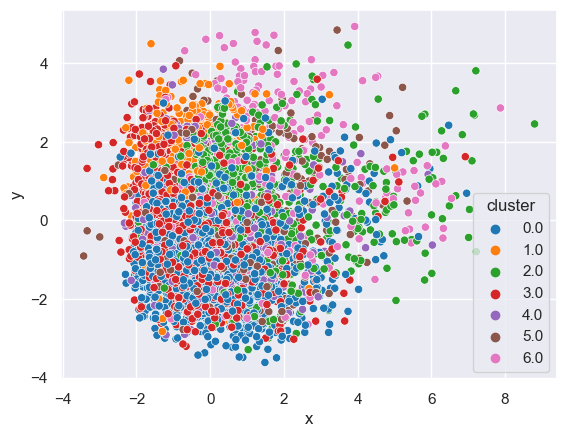

In [377]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_gm_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline GaussianMixture with UMAP

In [378]:
#Creating pipeline with a scaler, umap for dimensionality reduction and Gaussian Mixture
gm_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', GaussianMixture(n_components=7))])

In [379]:
#Creating a copy of the dataframe for modeling
gm_umap_song_df = rec_df.select_dtypes(np.number)
gm_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [380]:
#Using fit_predict function to generate cluster predictions
gm_umap_song_cluster_labels = gm_cluster_pipeline.fit_predict(gm_umap_song_df)

In [381]:
#Adding predictions to the dataframe
gm_umap_song_df['cluster_label'] = gm_umap_song_cluster_labels

In [382]:
#Checking output
gm_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,4


In [383]:
#Checking unsupervised learning metrics
clustering_metrics(gm_umap_song_df.drop('cluster_label', axis=1), gm_umap_song_cluster_labels)

Silhouette Score:  -0.13497679087626635 

 -------------------------- 


Calinski Harabasz Score:  64.75176047174878  

 -------------------------- 


Davies Bouldin Score:  35.22272480576055 

 -------------------------- 




In [384]:
#Using umap step to provide 2 dimensional data for visualization
gm_umap_db = gm_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [385]:
#Creating a dataframe using umap information
gm_umap_df = pd.DataFrame(gm_umap_db, columns=['umap_1', 'umap_2'])

In [386]:
#Adding prediction to umap dataframe
gm_umap_df['cluster'] = gm_umap_song_df['cluster_label']

In [387]:
#Checking output
gm_umap_df

,umap_1,umap_2,cluster
0,13.650434,13.313495,1.0
1,13.647152,13.318155,1.0
2,13.645221,13.310120,0.0
3,13.656034,13.317060,1.0
4,13.689800,13.332603,0.0
...,...,...,...
6508,13.637380,13.301431,1.0
6509,13.671185,13.332397,4.0
6510,13.637977,13.310351,1.0
6511,13.686614,13.270549,4.0


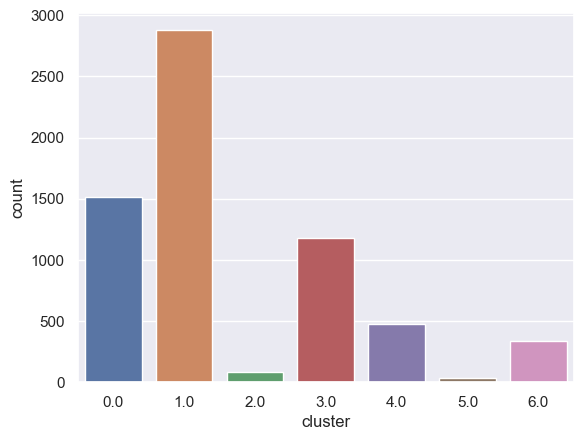

In [388]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gm_umap_df, x = 'cluster');

In [389]:
#Checking counts of songs per cluster
gm_umap_df['cluster'].value_counts()

1.0    2878
0.0    1518
3.0    1180
4.0     477
6.0     341
2.0      86
5.0      32
Name: cluster, dtype: int64

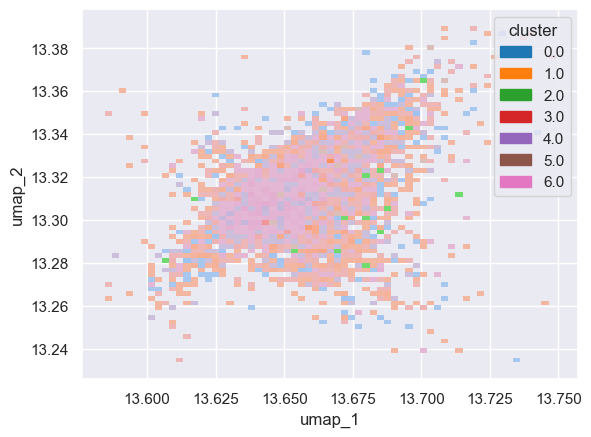

In [390]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = gm_umap_df, hue = 'cluster', palette = 'tab10');

In [391]:
#Visualizing clusters using plotly
px.scatter(gm_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

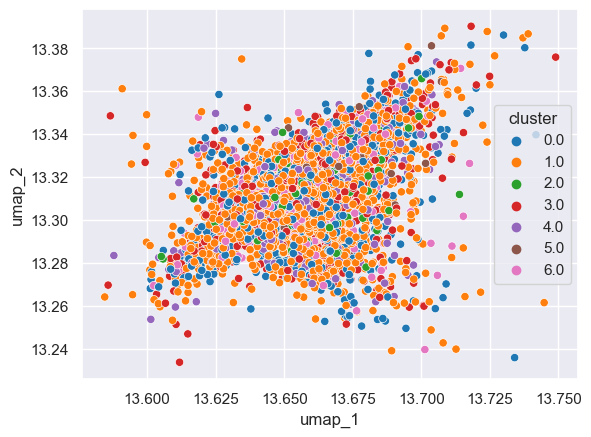

In [392]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = gm_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline GaussianMixture with PCA

In [393]:
#Creating a copy of the dataframe for modeling
pca_gm_df = rec_df.copy()

In [394]:
#Checking output
pca_gm_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [395]:
#Creating pipeline with a scaler, PCA for dimensionality reduction and Guassian Mixture
gm_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', GaussianMixture(n_components=7))])

In [396]:
#Using fit_predict function to generate cluster predictions
pca_gm_preds = gm_pca_cluster_pipeline.fit_predict(pca_gm_df.select_dtypes(np.number))

In [397]:
#Checking output
pca_gm_preds

array([4, 4, 5, ..., 5, 5, 4], dtype=int64)

In [398]:
#Checking PCA components
gm_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [399]:
#Checking total variance explained
gm_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [400]:
#Adding predictions to dataframe
pca_gm_df['cluster_label'] = pca_gm_preds

In [401]:
#Checking output
pca_gm_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,5
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,3
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,5
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,5
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,5


In [402]:
#Using PCA pipeline to turn the data into 2 dimensions for visualization
projection_gm_pca = PCA_pipeline(StandardScaler(), pca_gm_df)

In [403]:
#Checking output
projection_gm_pca

,x,y,artist,title,cluster
0,-0.617082,-0.333204,Bon Jovi,Livin' On A Prayer,4.0
1,0.320421,-1.953027,Bon Jovi,Wanted Dead Or Alive,4.0
2,0.313883,0.795776,Queen,We Are The Champions - Remastered 2011,5.0
3,-0.281376,1.443895,Queen,We Will Rock You - Remastered 2011,3.0
4,-1.348153,-0.093449,Bon Jovi,You Give Love A Bad Name,5.0
...,...,...,...,...,...
6508,-2.077760,1.290277,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,4.0
6509,-0.333936,2.000443,N.W.A.,Gangsta Gangsta,5.0
6510,-2.582358,0.662191,Various Artists,Rollin' With My Homies,4.0
6511,-2.854034,0.684286,Nas,N.Y. State of Mind,5.0


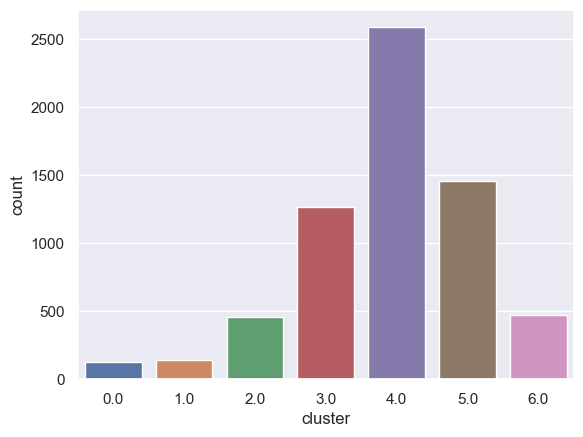

In [404]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=projection_gm_pca, x = 'cluster');

In [405]:
#Checking counts of songs per cluster
projection_gm_pca['cluster'].value_counts()

4.0    2588
5.0    1457
3.0    1265
6.0     474
2.0     458
1.0     142
0.0     128
Name: cluster, dtype: int64

In [406]:
#Visualizing clusters using plotly
plot_clusters(projection_gm_pca, 'x', 'y')

In [407]:
#Checking unsupervised learning metrics
clustering_metrics(pca_gm_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_gm_preds)

Silhouette Score:  -0.21846152187046874 

 -------------------------- 


Calinski Harabasz Score:  84.94445493384538  

 -------------------------- 


Davies Bouldin Score:  122.27581049239942 

 -------------------------- 




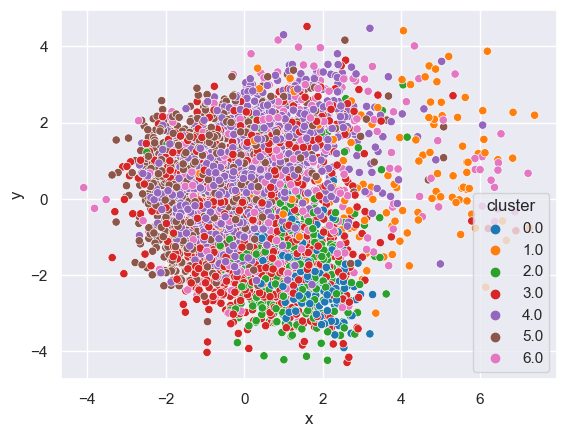

In [408]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = projection_gm_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch GaussianMixture with UMAP

In [409]:
#Creating a copy of the dataframe for modeling
gs_gm_umap_df = rec_df.copy().select_dtypes(np.number)

In [410]:
#Checking output
gs_gm_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [411]:
#Creating a pipeline using a scaler, umap for dimensionality reduction and Gaussian Mixture
gm_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', GaussianMixture())])


In [412]:
#Creating a parameter grid to find the best model through gridsearch
gm_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_components': [5, 7, 9, 13],
                    'model__max_iter':[100, 500, 1000],
                
                        }


In [413]:
#Inputting pipeline, parameter grid, custom scorer and removing cv for gridsearch
gm_gs_umap = GridSearchCV(estimator= gm_pipe_gs_umap, 
                              param_grid = gm_umap_grid, 
                             cv=cv)

In [414]:
#Fitting models
gm_gs_umap.fit(gs_gm_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', GaussianMixture())]),
             param_grid={'model__max_iter': [100, 500, 1000],
                         'model__n_components': [5, 7, 9, 13],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]})

In [417]:
#Checking the best parameters from the gridsearch
gm_gs_umap.best_params_

{'model__max_iter': 100,
 'model__n_components': 13,
 'umap__min_dist': 0.5,
 'umap__n_neighbors': 100}

In [418]:
#Checking the best score from the gridsearch
gm_gs_umap.best_score_

-4.438855190198111

In [419]:
#Checking the score based on gridsearch
gm_gs_umap.scorer_

<function sklearn.metrics._scorer._passthrough_scorer(estimator, *args, **kwargs)>

In [420]:
#Using predict function to generate cluster predictions
preds_gm_umap = gm_gs_umap.predict(gs_gm_umap_df)

In [421]:
#Checking output
preds_gm_umap

array([ 3,  2,  9, ..., 10, 10,  6], dtype=int64)

In [422]:
#Adding predictions to the dataframe
gs_gm_umap_df['cluster'] = preds_gm_umap

In [423]:
#Checking output
gs_gm_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,3
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,2
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,9
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,10
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,10
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,10


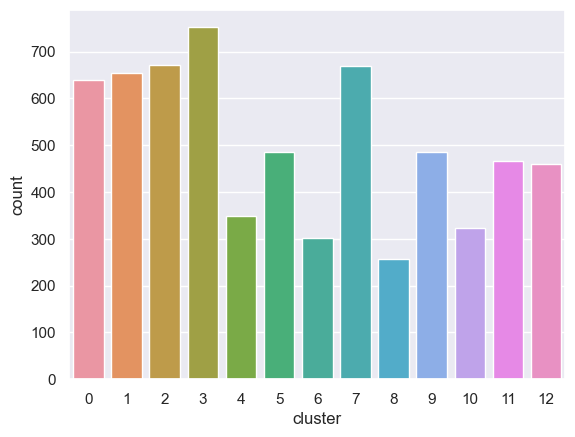

In [424]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_gm_umap_df, x = 'cluster');

In [425]:
#Checking counts of songs per cluster
gs_gm_umap_df['cluster'].value_counts()

3     752
2     671
7     670
1     655
0     639
9     485
5     485
11    466
12    460
4     348
10    323
6     302
8     257
Name: cluster, dtype: int64

In [426]:
#Using umap step to provide 2 dimensional data for visualization
gm_gs_umap_db = gm_gs_umap.best_estimator_.named_steps['umap'].transform(gs_gm_umap_df.drop('cluster', axis=1))

In [427]:
#Creating a dataframe from umap information
gm_gs_umap_df = pd.DataFrame(gm_gs_umap_db, columns=['umap_1', 'umap_2'])

In [428]:
#Checking for missing information
gm_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [429]:
#Adding predictions to umap dataframe
gm_gs_umap_df['cluster'] = gs_gm_umap_df['cluster']

In [430]:
#Checking output
gm_gs_umap_df

,umap_1,umap_2,cluster
0,6.848185,-0.738317,3.0
1,6.782054,-0.847027,2.0
2,6.900908,-0.736986,9.0
3,6.770149,-0.824751,0.0
4,6.899563,-0.748541,5.0
...,...,...,...
6508,6.836253,-0.879260,11.0
6509,6.923551,-0.706769,10.0
6510,6.921446,-0.688155,0.0
6511,6.975218,-0.656810,10.0


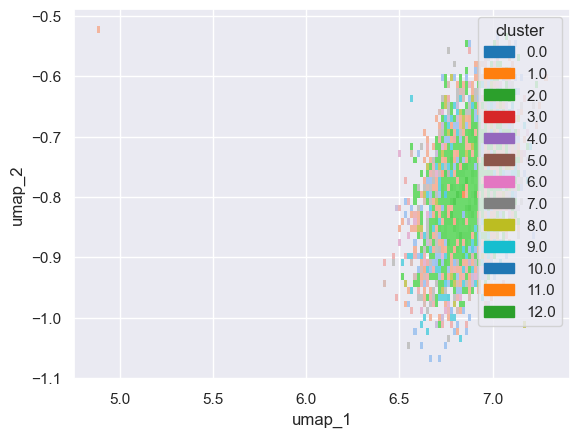

In [431]:
#Visualizing clusters using seaborn
sns.histplot(x = 'umap_1', y = 'umap_2', data = gm_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [432]:
#Visualizing clusters using plotly
px.scatter(gm_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

In [433]:
#Checking unsupervised learning metrics
clustering_metrics(gm_gs_umap_df.drop('cluster', axis=1), preds_gm_umap)

Silhouette Score:  -0.04250484 

 -------------------------- 


Calinski Harabasz Score:  1.002887692874208  

 -------------------------- 


Davies Bouldin Score:  105.83246862162478 

 -------------------------- 




### Gridsearch GaussianMixture with PCA

In [434]:
#Creating a copy of the dataframe for modeling
gs_gm_pca_df = rec_df.copy().select_dtypes(np.number)

In [435]:
#Checking output
gs_gm_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [436]:
#Creating pipeline with a scaler, PCA for dimensionality reduction and Gaussian Mixture
gm_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', GaussianMixture())])

In [437]:
#Creating a parameter grid to find the best model through gridsearch
gm_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_components': [5, 7, 9, 13],
                    'model__max_iter':[100, 500, 1000],
                  }


In [438]:
#Inputting pipeline, parameter grid, custom scorer and removing cv for gridsearch
gm_gs_pca = GridSearchCV(estimator=gm_pipe_gs_pca,
                             param_grid = gm_pca_grid,
                             cv=cv)

In [439]:
#Fitting models
gm_gs_pca.fit(gs_gm_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', GaussianMixture())]),
             param_grid={'model__max_iter': [100, 500, 1000],
                         'model__n_components': [5, 7, 9, 13],
                         'pca__n_components': [9, 11, 13, 'mle']})

In [440]:
#Using predict to generate cluster predictions
gm_pca_preds = gm_gs_pca.predict(gs_gm_pca_df)

In [441]:
#Adding predictions to dataframe
gs_gm_pca_df['cluster'] = gm_pca_preds

In [442]:
#Checking outputs
gs_gm_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


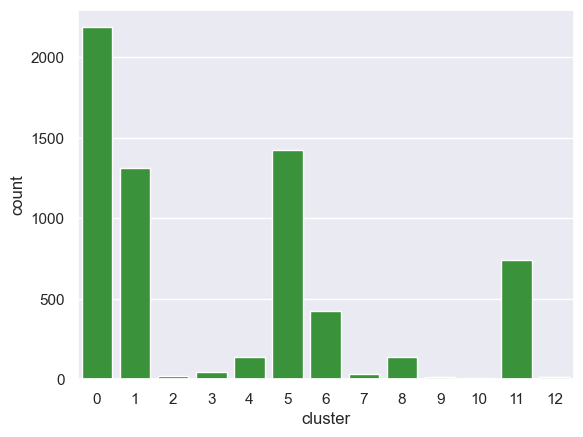

In [443]:
#Visualizing counts of songs per cluster using seaborn
sns.countplot(data=gs_gm_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [444]:
#Checking unsupervised learning metrics
clustering_metrics(gs_gm_pca_df.drop('cluster', axis=1), gm_pca_preds)

Silhouette Score:  -0.2705774241121747 

 -------------------------- 


Calinski Harabasz Score:  67.6998808419213  

 -------------------------- 


Davies Bouldin Score:  112.19512304372125 

 -------------------------- 




In [445]:
#Checking best parameters from the gridsearch
gm_gs_pca.best_params_

{'model__max_iter': 1000, 'model__n_components': 13, 'pca__n_components': 13}

In [446]:
#Checking the best score from the gridsearch
gm_gs_pca.best_score_

0.08796037623234536

In [447]:
#Checking the scorer used in the gridsearch
gm_gs_pca.scorer_

<function sklearn.metrics._scorer._passthrough_scorer(estimator, *args, **kwargs)>

In [448]:
#Creating PCA pipeline to turn data into 2 dimensions for visualization
gm_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

#Creating dataframe for PCA output
songs_gm_pca = gs_gm_pca_df 
song_embedding_gm_pca = gm_pca_pipeline.fit_transform(songs_gm_pca)
projection_gm_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_gm_pca)

#Adding artist, track name and cluster predictions to the dataframe
projection_gm_pca['artist'] = rec_df['artist']
projection_gm_pca['title'] = rec_df['track_name']
projection_gm_pca['cluster'] = gs_gm_pca_df['cluster']

In [449]:
projection_gm_pca

,x,y,artist,title,cluster
0,-0.978141,-0.451741,Bon Jovi,Livin' On A Prayer,0.0
1,1.545967,-1.560052,Bon Jovi,Wanted Dead Or Alive,6.0
2,0.279877,0.661282,Queen,We Are The Champions - Remastered 2011,1.0
3,-1.909643,1.314243,Queen,We Will Rock You - Remastered 2011,0.0
4,-0.773367,-0.887187,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-1.993793,-0.126487,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,0.0
6509,-1.952204,1.699820,N.W.A.,Gangsta Gangsta,1.0
6510,-2.086952,-0.924378,Various Artists,Rollin' With My Homies,0.0
6511,-2.229934,-1.074982,Nas,N.Y. State of Mind,1.0


In [450]:
#Visualizing clusters using plotly
plot_clusters(projection_gm_pca, 'x', 'y')

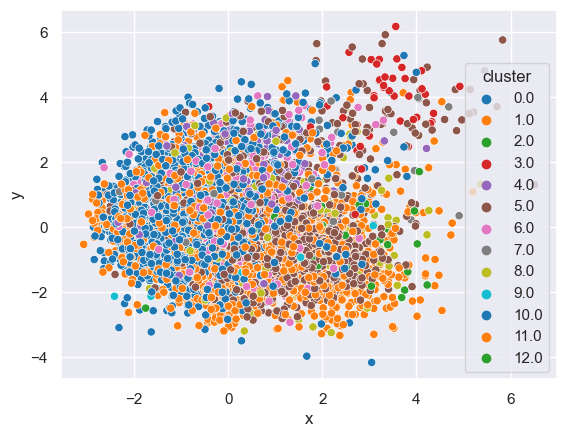

In [451]:
#Visualizing clusters using seaborn's scatterplot
sns.scatterplot(data = projection_gm_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## Final Model - Baseline MiniBatchKMeans with PCA

In [452]:
final_model_pipe_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('pca', PCA(n_components=9)),
                                    ('model', MiniBatchKMeans())])

In [453]:
mbkmeans_pca_song_df = rec_df.select_dtypes(np.number)
mbkmeans_pca_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [454]:
final_model_pipe_pca.fit(mbkmeans_pca_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=9)),
                ('model', MiniBatchKMeans())])

In [455]:
filename_pca = 'finalized_model_pca.pkl'

In [456]:
pickle.dump(final_model_pipe_pca, open(filename_pca, 'wb'))

## Final Model - MiniBatchKMeans with UMAP

In [457]:
final_model_pipe = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP(min_dist=0.8)),
                                    ('model', MiniBatchKMeans(batch_size = 1024,
                                                              max_iter = 100,
                                                              n_clusters= 7))])

In [458]:
mbkmeans_base_song_df = rec_df.select_dtypes(np.number)
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [459]:
final_model_pipe.fit(mbkmeans_base_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



Pipeline(steps=[('scaler', StandardScaler()),
                ('umap',
                 UMAP(min_dist=0.8, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})),
                ('model', MiniBatchKMeans(n_clusters=7))])

In [460]:
import pickle

filename = 'finalized_model.pkl'
pickle.dump(final_model_pipe, open(filename, 'wb'))